# CLUSTER ANALYSIS OF TISSUE DATASETS FILTERED BY CLOCKS

# Approach:
To understand how the clock is affected by the type of tissue, we will perform cluster analysis using the tissue-specific datasets filtered from the full methylation dataset. We will use and compare several clustering algorithms (K-Mean, Hierarchical clustering and DBSCANN) to group the tissues based on the methylation levels of the CpG sites. We will then analyze the clusters to identify the tissues that have similar methylation patterns and identify CpG sites that are differentially methylated between the clusters.

# Goal
Measuring the similarity between tissues based on the methylation levels of the CpG sites can help us understand how the clock is affected by the type of tissue. By identifying tissues with similar methylation patterns, we can gain insights into the underlying biological processes that drive the aging process in different tissues.

STEPS:
- Feature Selection: Use the clock dataset to select the top CpGs identified by the clocks to be informative for age prediction. These CpGs will serve as features for clustering.
- Clustering: Apply a clustering algorithm to each tissue-specific dataset separately using the selected CpGs as features. 
- Cluster Analysis: Analyze the clusters to identify tissues with similar methylation patterns and CpGs that are differentially methylated between the clusters.
- Validation: Validate the stability and reproducibility of the clusters using appropriate methods such as bootstrapping or cross-validation.

NOTES:
Finding the best K: The K-means algorithm requires the number of clusters (K) to be specified in advance. To determine the optimal number of clusters, we will use the elbow method, silhouette score, and gap statistic. The best measure of K is the silhouette score, which is a measure of how similar an object is to its own cluster compared to other clusters. The silhouette score ranges from -1 to 1, where a high value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters.

In [298]:
### Functions

# Function to create a clustered heatmap


def clustered_heatmap_only(tissue_name, tissue_dataset, labels, model):

    """ 
    Generates a clustered heatmap to visualize relationships in biological data across different samples, 
    particularly useful for exploring DNA methylation levels. 

    Parameters:
    - tissue_name: Name of the tissue type being analyzed.
    - tissue_dataset: DataFrame containing the dataset to visualize, where the columns are CpGs and the rows are samples.
    - labels: Cluster labels assigned to each sample.

    This function is intended to be used within a loop iterating over the best clustering results for each tissue.

    """
    
    # Get the cluster labels
    labels = labels

    # Order the dataset based on the cluster labels
    ordered_dataset = tissue_dataset.copy() # Make a copy of the dataset
    ordered_dataset['cluster'] = labels # Add the cluster labels to the dataset
    n_clusters = len(ordered_dataset['cluster'].unique()) # Get the number of clusters
    ordered_dataset = ordered_dataset.sort_values(by='cluster') # Sort by cluster
    ordered_dataset = ordered_dataset.drop(columns='cluster')
    

    # Create the clustermap
    g = sns.clustermap(ordered_dataset, # dataset to plot
                       cmap='RdBu_r',  # color map
                       metric='euclidean', # distance metric for clustering 
                       z_score=None,  # Z score the data
                       standard_scale=None, # Standardize the data
                       figsize=(10, 8),  # Set figure size here
                       cbar_kws={'label': 'CpGs Beta-value', 'orientation': 'vertical'}) # Colorbar settings
     
    # Move the title to the top of the figure
    plt.gcf().suptitle(f'{model} Clustered Heatmap for {tissue_name} Tissue\n Samples: {tissue_dataset.shape[0]}, CpGs: {tissue_dataset.shape[1]}, Clusters: {n_clusters}', 
                       fontsize=13, 
                       fontweight='bold', 
                       y=1 # Adjust the vertical position of the title, 0 is bottom, 1 is top
                       )

    # Add the label 'Samples' to the rows
    g.ax_heatmap.set_ylabel('Samples')

    # Adjust layout to add padding around the heatmap
    plt.gcf().tight_layout()

    # Manually adjust the position the color bar to match the size of the heatmap
    g.cax.set_position([1, 0.54, 0.02, 0.20])  # [x, y, width, height]
  
    
    plt.show()

############################################### 


def clustered_heatmaps_and_cpgs(tissue_name, tissue_dataset, labels, model, folder):

    """

    Generates a clustered heatmap to visualize the clustering results of some clustering models,
    as well as extracts the hierarchica clustering of the features performed during the clustering. 

    Parameters:
    - tissue_name: Name of the tissue type being analyzed.
    - tissue_dataset: DataFrame containing the dataset to visualize, where the columns are CpGs and the rows are samples.
    - labels: Cluster labels assigned to each sample.
    - folder: Folder where CpG clustering results should be save.

    This function is intended to be used within a loop iterating over the best clustering results for each tissue

    """ 

    # Get the cluster labels
    labels = labels

    # Order the dataset based on the cluster labels
    ordered_dataset = tissue_dataset.copy()  # Make a copy of the dataset
    ordered_dataset['cluster'] = labels  # Add the cluster labels to the dataset
    n_clusters = len(ordered_dataset['cluster'].unique())  # Get the number of clusters
    ordered_dataset = ordered_dataset.sort_values(by='cluster')  # Sort by cluster
    ordered_dataset = ordered_dataset.drop(columns='cluster')

    # Create the clustermap
    g = sns.clustermap(ordered_dataset,  # dataset to plot
                       cmap='RdBu_r',  # color map
                       metric='euclidean',  # distance metric for clustering 
                       z_score=None,  # Z score the data
                       standard_scale=None,  # Standardize the data
                       figsize=(10, 8),  # Set figure size here
                       cbar_kws={'label': 'CpGs Beta-value', 'orientation': 'vertical'})  # Colorbar settings
    
    ## Extract the linkage matrix used by sns.clustermap
    linkage_matrix = g.dendrogram_col.linkage

    ## Calculate the distance threshold manually
    distance_threshold = 0.7 * np.max(linkage_matrix[:, 2]) # the distance threshold is set to 70% of the max distance in the linkage matrix. This choice of 70% is a value that is commonly used in practice.

    # Define a cutoff distance to form flat clusters
    cpg_clusters = fcluster(linkage_matrix, t=distance_threshold, criterion='distance')

    # Get CpG labels
    cpg_labels = ordered_dataset.columns

    # Create a DataFrame to see which CpGs are in which clusters
    cpg_cluster_df = pd.DataFrame({'CpG': cpg_labels, 'Cluster': cpg_clusters})

    # Move the title to the top of the figure
    plt.gcf().suptitle(f'{model} Clustered Heatmap for {tissue_name} Tissue\n Samples: {tissue_dataset.shape[0]}, CpGs: {tissue_dataset.shape[1]}, Clusters: {n_clusters}', 
                       fontsize=13, 
                       fontweight='bold', 
                       y=1  # Adjust the vertical position of the title, 0 is bottom, 1 is top
                       )

    # Add the label 'Samples' to the rows
    g.ax_heatmap.set_ylabel('Samples')

    # Adjust layout to add padding around the heatmap
    plt.gcf().tight_layout()

    # Manually adjust the position of the color bar to match the size of the heatmap
    g.cax.set_position([1, 0.54, 0.02, 0.20])  # [x, y, width, height]
  
    plt.show()

    # save the df in a csv 
    folder = folder
    os.makedirs(folder, exist_ok=True)
    filepath = os.path.join(folder, f'{tissue_name}_CpG_heatmap_clusters_{model}.csv')
    cpg_cluster_df.to_csv(filepath, index=False)


## 0. Load data and filter datasets by clocks (Clock1 so far...)

In [118]:
#### LOAD: libraries
import os
import pandas as pd
import numpy as np
import seaborn as sns

from itertools import combinations

import matplotlib.cm as cm  
from matplotlib import colormaps as mcolors
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, jaccard_score

from scipy.spatial.distance import euclidean
from scipy.cluster.hierarchy import single, cophenet, linkage, dendrogram, fcluster
from scipy.spatial.distance import pdist, cityblock, squareform, euclidean
from scipy.stats import f_oneway




In [119]:
#### LOAD: Metadata
metadata = pd.read_csv('GSE223748_complete_metadata.csv')

In [140]:
#### LOAD: Complete methylation data

complete_methylation = pd.read_csv('GSE223748_datBetaNormalized.csv')

In [3]:
# Check number of cortex samples
print('Number of samples:', metadata[metadata['Tissue'] == 'Testis'].shape[0])

Number of samples: 1


In [120]:
#### LOAD: Tissue-specific methylation datasets from the saved CSV files

folder_name = "Tissue Methylation"
tissue_files = os.listdir(folder_name) # Get a list of all files in the folder
tissues_df = metadata[['Sample', 'Tissue']]
tissues = tissues_df['Tissue'].unique() # Get a list of all tissues

# Load each CSV file into its own dataframe
for file in tissue_files:
    if file.endswith("_methylation_dataset.csv"):
        # Extract tissue name from file name
        tissue = file.split("_")[0]

        # Load CSV file into dataframe
        file_path = os.path.join(folder_name, file)
        globals()['{}_methylation_dataset'.format(tissue)] = pd.read_csv(file_path)

In [121]:
#### LOAD: Methylation data for the complete CpGs of each clock
clock1 = pd.read_csv('./Clocks Methylation Data/Clock1_Methylation_data_complete.csv')
clock2 = pd.read_csv('./Clocks Methylation Data/Clock2_Methylation_data_complete.csv')
clock3 = pd.read_csv('./Clocks Methylation Data/Clock3_Methylation_data_complete.csv')
clock2_3 = pd.read_csv('./Clocks Methylation Data/Clock2_3_Overlap_Methylation_data_complete.csv')


In [ ]:
#### Filter the complete methylation dataset by the CpGs in Clock1
clock1_cpgs = clock1['CpG'].values
complete_methylation_dataset_clock1_filtered = complete_methylation[complete_methylation['CpG'].isin(clock1_cpgs)]
complete_methylation_dataset_clock1_filtered.shape

In [122]:
#### Filter the all tissues-specific datasets by the CpGs in Clock 1
clock1_cpgs = clock1['CpG'].values

for tissue in tissues:
    tissue_df = globals()['{}_methylation_dataset'.format(tissue)].copy()
    tissue_df = tissue_df[tissue_df['CpG'].isin(clock1_cpgs)]
    globals()['{}_methylation_dataset_clock1_filtered'.format(tissue)] = tissue_df

# Note to self: the resulting variables will be named as follows: Blood_methylation_dataset_clock1_filtered

In [295]:
# Create a dataframe with the tissue names and respective filtered datasets

# List with tissue datasets
tissues = tissues_df['Tissue'].unique() # Get a list of all tissues
tissue_datasets = pd.DataFrame(columns=['Tissue', 'Dataset']) # create a dataframe to store the datasets

# fill the dictionary with dataset and respective tissue name
for tissue in tissues:
    tissue_datasets.loc[len(tissue_datasets)] = [tissue, globals()['{}_methylation_dataset_clock1_filtered'.format(tissue)]]

tissue_datasets.head()

,Tissue,Dataset
0,Cortex,CpG 202794570001_R01C01 202794...
1,Liver,CpG 202794570002_R01C01 202794...
2,Blood,CpG 202794570002_R01C02 202794...
3,Skin,CpG 202794570010_R01C01 202794...
4,Muscle,CpG 202894750009_R02C02 202894...


In [264]:
# Get just the first 2 datasets for testing
tissue_datasets_test = tissue_datasets.iloc[0:2]
tissue_datasets_test.head()

,Tissue,Dataset
0,Cortex,CpG 202794570001_R01C01 202794...
1,Liver,CpG 202794570002_R01C01 202794...


#### EXAMPLE - testing with just one tissue dataset (Blood) 

In [138]:
tissue_datasets

,Tissue,Dataset
0,Cortex,CpG 202794570001_R01C01 202794...
1,Liver,CpG 202794570002_R01C01 202794...
2,Blood,CpG 202794570002_R01C02 202794...
3,Skin,CpG 202794570010_R01C01 202794...
4,Muscle,CpG 202894750009_R02C02 202894...
...,...,...
65,Villi,CpG 205619060032_R01C02 205619...
66,Crypts,CpG 205619060032_R02C02 205619...
67,DifferentiatedBloodCells,CpG 205619060032_R03C01 205619...
68,HematopoieticStemCells,CpG 205619060032_R05C01 205619...


In [8]:
Blood_methylation_dataset_clock1_filtered.head()

,CpG,202794570002_R01C02,202794570002_R03C02,202794570002_R04C02,202794570002_R05C02,202794570002_R06C01,202794570002_R06C02,202794570020_R01C01,202794570020_R01C02,202794570020_R02C01,...,205987790065_R03C02,205987790065_R04C01,205987790065_R04C02,205987790065_R05C01,205987790065_R05C02,205987790065_R06C01,205987790065_R06C02,206139140104_R01C02,206139140104_R02C02,206139140104_R06C01
352,cg00249943,0.927281,0.880088,0.920493,0.884974,0.869905,0.930239,0.928982,0.916086,0.925254,...,0.906122,0.909503,0.908647,0.905427,0.917909,0.912636,0.930070,0.871767,0.866891,0.846518
355,cg00250826,0.917848,0.904607,0.895305,0.889923,0.919690,0.895465,0.899427,0.919050,0.891624,...,0.885499,0.930252,0.899952,0.919857,0.910695,0.915280,0.918941,0.938935,0.914406,0.908553
415,cg00292639,0.952901,0.925491,0.928113,0.927688,0.850198,0.933530,0.921912,0.945296,0.927747,...,0.932465,0.926448,0.923082,0.929570,0.927240,0.926080,0.933664,0.853267,0.735366,0.677584
502,cg00362836,0.895697,0.912484,0.916256,0.898523,0.902138,0.917622,0.913933,0.911002,0.913857,...,0.656572,0.756802,0.650944,0.732797,0.716311,0.679906,0.713399,0.504127,0.477792,0.462529
555,cg00411555,0.858765,0.897961,0.876293,0.855455,0.866865,0.887719,0.852766,0.836740,0.882575,...,0.880823,0.927749,0.898857,0.913282,0.906163,0.929660,0.891589,0.478721,0.479801,0.504832


In [9]:
# Check if any dataset has less than 3 cols
for tissue in tissues:
    tissue_df = globals()['{}_methylation_dataset_clock1_filtered'.format(tissue)]
    if tissue_df.shape[1] < 3:
        print(tissue)

Testis
Thyroid
Dermis


In [10]:
#### K-means models for the filtered blood dataset (Clock1)

# Select the data
X = Blood_methylation_dataset_clock1_filtered.iloc[:, 1:]

# Standardize the data
sc = StandardScaler()
X = sc.fit_transform(X)

# Train the model and test different values of k
results = pd.DataFrame(columns=['k', 'silhouette_score', 'cluster_centers'])
k_values = range(2, 20)
wcss = [] # Within-cluster sum of squares

for k in k_values:
    # Initialize k-means clustering with current parameters
    kmeans = KMeans(n_clusters=k, random_state=42)
    
    # Fit the model to your data
    kmeans.fit(X)
    
    # Calculate silhouette score to evaluate the clustering
    silhouette_avg = silhouette_score(X, kmeans.labels_)

    # Add results to result DataFrame
    results.loc[len(results)] = [k, silhouette_avg, kmeans.cluster_centers_]

results.sort_values(by='silhouette_score', ascending=False).head()


,k,silhouette_score,cluster_centers
0,2,0.519852,"[[-0.7925350391663095, -0.7850403366403931, -0..."
1,3,0.471180,"[[0.016032142233011512, -0.02853080660017119, ..."
2,4,0.383094,"[[-0.2253440641839407, -0.24847165850770975, -..."
3,5,0.339530,"[[-0.5543068876160606, -0.567179540395981, -0...."
4,6,0.314892,"[[0.26519062081328393, 0.19487961931315786, 0...."


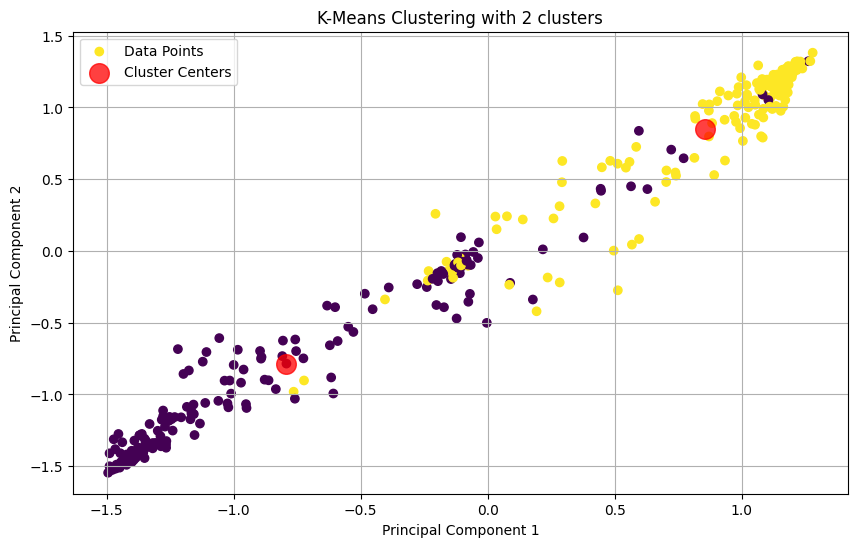

In [11]:
#### Scatter plot of data with best number of clusters according to silhouette score

# Initialize k-means clustering with n clusters
n_clusters = results['k'].iloc[0] # Use the best k value from the previous step
kmeans = KMeans(n_clusters, random_state=42)

# Fit the model to your data
kmeans.fit(X)

# Get the cluster labels
labels = kmeans.labels_

# Get the cluster centers
centers = kmeans.cluster_centers_

# Plot the data
plt.figure(figsize=(10, 6))
plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title(f'K-Means Clustering with {n_clusters} clusters')
plt.legend(['Data Points', 'Cluster Centers'])
plt.grid()
plt.show()

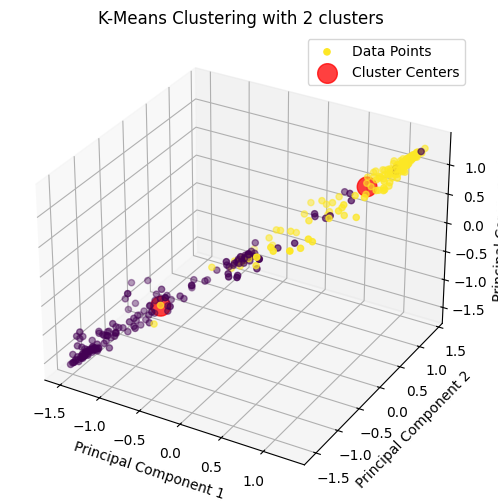

In [12]:
### 3D visualisation of the clusters

from mpl_toolkits.mplot3d import Axes3D

# Initialize k-means clustering with n clusters
n_clusters = results['k'].iloc[0] # Use the best k value from the previous step
kmeans = KMeans(n_clusters, random_state=42)

# Fit the model to your data
kmeans.fit(X)

# Get the cluster labels
labels = kmeans.labels_

# Get the cluster centers
centers = kmeans.cluster_centers_

# Plot the data
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=labels, cmap='viridis')
ax.scatter(centers[:, 0], centers[:, 1], centers[:, 2], c='red', s=200, alpha=0.75)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title(f'K-Means Clustering with {n_clusters} clusters')
plt.legend(['Data Points', 'Cluster Centers'])
plt.grid()
plt.show()


In [13]:
# Get the list of CpGs in each cluster
Blood_methylation_dataset_clock1_filtered['Cluster'] = labels
clustered_cpgs = Blood_methylation_dataset_clock1_filtered[['CpG', 'Cluster']]
clustered_cpgs.head()

,CpG,Cluster
352,cg00249943,1
355,cg00250826,1
415,cg00292639,1
502,cg00362836,1
555,cg00411555,1


In [14]:
### Quick summary of CpGs clustered
print('Total number of CpGs used: ', len(Blood_methylation_dataset_clock1_filtered))
print('Number of CpGs wihtout a cluster: ', len(clustered_cpgs[clustered_cpgs['Cluster'] == -1]))
print('Number of CpGs in cluster 1: ', len(clustered_cpgs[clustered_cpgs['Cluster'] == 0]))
print('Number of CpGs in cluster 2: ', len(clustered_cpgs[clustered_cpgs['Cluster'] == 1]))


Total number of CpGs used:  335
Number of CpGs wihtout a cluster:  0
Number of CpGs in cluster 1:  174
Number of CpGs in cluster 2:  161


In [15]:
# total of CpGs with
clustered_cpgs.shape[0]

335

## 1. K-MEANS clutering of CpGs from all tissue datasets filtered by Clock1

### 1.1. K-Means Clustering of Full Methylation Dataset filtered by CpGs in Clock 1

In [ ]:
km_results_complete = pd.DataFrame(columns=['Tissue', 'k', 'silhouette_score', 'cluster_centers'])

complete_dataset = complete_methylation_dataset_clock1_filtered.set_index('CpG').transpose()
complete_dataset.shape()

# Select the data
X = complete_dataset.iloc[:, 1:]
X

# Standardize the data
sc = StandardScaler()
X = sc.fit_transform(X)

# Train the model and test different values of k
k_values = range(2, 20)

for k in k_values:
    # Initialize k-means clustering with current parameters
    kmeans = KMeans(n_clusters=k, random_state=42)
    
    # Fit the model to your data
    kmeans.fit(X)
    
    # Calculate silhouette score to evaluate the clustering
    silhouette_avg = silhouette_score(X, kmeans.labels_)

    # Add results to result DataFrame
    km_results_complete.loc[len(km_results_complete)] = [tissue, k, silhouette_avg, kmeans.cluster_centers_]

km_results_complete.sort_values(by='silhouette_score', ascending=False).head()
km_results_complete

### 1.2. K-Means clustering of tissue datasets filtered by CpGs in Clock 1

In [135]:
#### K-Mean loop for all tissue datasets using Sklearn - Transposed data

# Results dataframe
km_results = pd.DataFrame(columns=['Tissue','k', 'silhouette_score', 'cluster_centers', 'cluster_labels', 'sum of labels', ' total features', 'dataset shape'])
km_results_errors = pd.DataFrame(columns=['Tissue','k', 'Error'])


# Loop through all tissue datasets
for index, row in tissue_datasets.iterrows():
    tissue_name = row['Tissue']
    tissue_dataset = row['Dataset']

    # Transpose the dataset so that CpGs are columns and samples are rows
    tissue_dataset = tissue_dataset.set_index('CpG').transpose()

    # Debug: Print the shape of the transposed dataset
    shape = tissue_dataset.shape

    # Check if there are enough samples for clustering
    if tissue_dataset.shape[0] < 2:
        # print(f"Not enough samples for clustering in {tissue_name}. Skipping...")
        # save the tissue name and k value that caused the error
        km_results_errors.loc[len(km_results_errors)] = [tissue_name, k, "Not enough samples for clustering"]
        continue
    
    # Split the data into training and testing sets for k-means
    X = tissue_dataset.iloc[:, :]  # All samples, all CpG features

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    # Train the model and test different values of k
    k_values = range(2, 20)
    
    for k in k_values:
        try:
            # Initialize k-means clustering with current parameters
            kmeans = KMeans(n_clusters=k, init='k-means++', random_state=42)
            
            # Fit the model to your data
            kmeans.fit(X)
            
            # Calculate silhouette score to evaluate the clustering
            silhouette_avg = silhouette_score(X, kmeans.labels_)

            # Add results to result DataFrame
            km_results.loc[len(km_results)] = [tissue_name, k, silhouette_avg, kmeans.cluster_centers_, kmeans.labels_, len(kmeans.labels_), tissue_dataset.shape[1], shape]
            
        except ValueError as e:
            # print(f"Error with k={k} for {tissue_name}: {e}")
            # save the tissue name and k value that caused the error, and save the error message as string
            km_results_errors.loc[len(km_results_errors)] = [tissue_name, k, str(e)]
            continue


# Sort results by silhouette score
km_results = km_results.sort_values(by='silhouette_score', ascending=False)

# Display the results
km_results

,Tissue,k,silhouette_score,cluster_centers,cluster_labels,sum of labels,total features,dataset shape
36,Blood,2,0.709689,"[[0.0066595261541173905, 8.912339431205742e-05...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",4554,335,"(4554, 335)"
418,Keratinocyte,2,0.606273,"[[0.18455063288182774, 0.1607935198815632, 0.1...","[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",22,335,"(22, 335)"
669,ES,2,0.539009,"[[-0.023909871269862916, -0.2990061336453633, ...","[1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",38,335,"(38, 335)"
622,Placenta,2,0.529202,"[[0.3192104990724323, 0.9713339363906273, 0.95...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",47,335,"(47, 335)"
202,Cerebellum,6,0.520945,"[[0.33084814412810837, 1.560071449363589, 1.97...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",367,335,"(367, 335)"
...,...,...,...,...,...,...,...,...
597,MacrophageBoneMarrow,13,0.000508,"[[0.16841419291809406, -0.4610070607724762, -0...","[8, 11, 4, 6, 5, 5, 5, 5, 0, 9, 5, 5, 2, 10, 7...",24,335,"(24, 335)"
588,MacrophageBoneMarrow,4,-0.002770,"[[-0.8435067693269203, 0.00015261030472333662,...","[2, 2, 2, 0, 3, 3, 3, 0, 0, 3, 3, 3, 2, 2, 1, ...",24,335,"(24, 335)"
589,MacrophageBoneMarrow,5,-0.004157,"[[-0.8435067693269203, 0.00015261030472333662,...","[4, 2, 2, 0, 3, 3, 3, 0, 0, 3, 3, 3, 2, 2, 1, ...",24,335,"(24, 335)"
590,MacrophageBoneMarrow,6,-0.005808,"[[0.16841419291809406, -0.4610070607724762, -0...","[4, 2, 2, 5, 5, 5, 5, 5, 0, 3, 5, 5, 2, 5, 1, ...",24,335,"(24, 335)"


In [125]:
km_results_errors.head()

,Tissue,k,Error
0,Testis,19,Not enough samples for clustering
1,Pancreas,2,Number of labels is 2. Valid values are 2 to n...
2,Pancreas,3,n_samples=2 should be >= n_clusters=3.
3,Pancreas,4,n_samples=2 should be >= n_clusters=4.
4,Pancreas,5,n_samples=2 should be >= n_clusters=5.


In [126]:
print('Number of tissue datasets for which clustering was not done due to low number of samples:', len(km_results_errors[km_results_errors['Error'] == 'Not enough samples for clustering']))

Number of tissue datasets for which clustering was not done due to low number of samples: 3


In [127]:
print('Datasets that were not clustered due to low number of samples:\n', km_results_errors[km_results_errors['Error'] == 'Not enough samples for clustering'])

Datasets that were not clustered due to low number of samples:
       Tissue   k                              Error
0     Testis  19  Not enough samples for clustering
19   Thyroid  19  Not enough samples for clustering
388   Dermis  19  Not enough samples for clustering


In [128]:
print('Number of combinations for which the dataset had less samples than Ks being tested:',
      len(km_results_errors[km_results_errors['Error'].str.contains('n_clusters')]))

Number of combinations for which the dataset had less samples than Ks being tested: 427


In [136]:
### K-Means best results: filtered clustering results for all tissues by best silhouette score - Transposed data

kmeans_best_results = km_results.sort_values(by='silhouette_score', ascending=False).groupby('Tissue').first().reset_index()
kmeans_best_results.sort_values(by='silhouette_score', ascending=False).head()

,Tissue,k,silhouette_score,cluster_centers,cluster_labels,sum of labels,total features,dataset shape
4,Blood,2,0.709689,"[[0.0066595261541173905, 8.912339431205742e-05...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",4554,335,"(4554, 335)"
25,Keratinocyte,2,0.606273,"[[0.18455063288182774, 0.1607935198815632, 0.1...","[1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",22,335,"(22, 335)"
13,ES,2,0.539009,"[[-0.023909871269862916, -0.2990061336453633, ...","[1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",38,335,"(38, 335)"
40,Placenta,2,0.529202,"[[0.3192104990724323, 0.9713339363906273, 0.95...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",47,335,"(47, 335)"
9,Cerebellum,6,0.520945,"[[0.33084814412810837, 1.560071449363589, 1.97...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",367,335,"(367, 335)"


In [267]:
# check adipose tissues
kmeans_best_results[kmeans_best_results['Tissue']=='Cortex']

,Tissue,k,silhouette_score,cluster_centers,cluster_labels,sum of labels,total features,dataset shape
10,Cortex,8,0.447384,"[[1.298868703843752, 1.1804887886450157, -3.87...","[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ...",714,335,"(714, 335)"


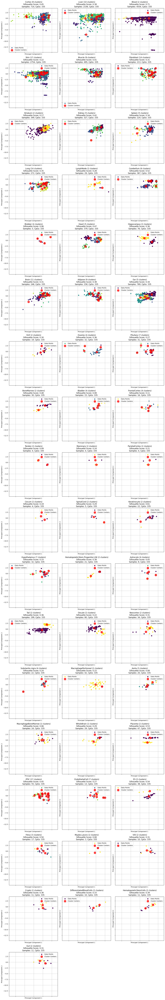

In [138]:
### Plots of the clustering results

# Create a figure with subplots for each tissue
num_tissues = len(tissue_datasets)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows), sharex=True, sharey=True)

# Loop through all tissues
subplot_idx = 0 # Keep track of the current subplot
for idx, (index, row) in enumerate(tissue_datasets.iterrows()):
    tissue_name = row['Tissue']
    tissue_dataset = row['Dataset']

    # Check that dataset has more than 3 columns
    if tissue_dataset.shape[1] < 3:
        continue  # Skip this subplot

    # Ensure there is a corresponding entry in kmeans_best_results
    best_k_entry = kmeans_best_results[kmeans_best_results['Tissue'] == tissue_name]
    if best_k_entry.empty:
        continue  # Skip this tissue if no best k value is found

    # Get the best k value for the tissue
    best_k = kmeans_best_results[kmeans_best_results['Tissue'] == tissue_name]['k'].values[0]
    silhouette = kmeans_best_results[kmeans_best_results['Tissue'] == tissue_name]['silhouette_score'].values[0]

    # Transpose the dataset so that CpGs are columns and samples are rows
    tissue_dataset = tissue_dataset.set_index('CpG').transpose()

    # Check if there are enough samples for clustering
    if tissue_dataset.shape[0] < 2:
        continue

    # Split the data into training and testing sets for k-means
    X = tissue_dataset.iloc[:, :]  # All samples, all CpG features

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    # Initialize k-means clustering with n clusters
    kmeans = KMeans(n_clusters=best_k, init='k-means++', random_state=42)

    # Fit the model to your data
    kmeans.fit(X)

    # Get the cluster labels
    labels = kmeans.labels_

    # Get the cluster centers
    centers = kmeans.cluster_centers_

    # Calculate subplot position so we can access the correct axis for plotting and remove unused subplots
    row_idx = subplot_idx // num_cols
    col_idx = subplot_idx % num_cols
    ax = axs[row_idx, col_idx]

    # Plot the data
    ax.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
    ax.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75)
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.set_title(f' {tissue_name} ({best_k} clusters)\nSilhouette Score: {(silhouette):.2f}\nSamples: {tissue_dataset.shape[0]}, CpGs: {tissue_dataset.shape[1]}')
    ax.legend(['Data Points', 'Cluster Centers'])
    ax.grid()

    subplot_idx += 1

# Remove any unused subplots
for i in range(subplot_idx, num_cols * num_rows):
    axs.flat[i].set_visible(False)

# Adjust the layout
plt.tight_layout()
plt.show()


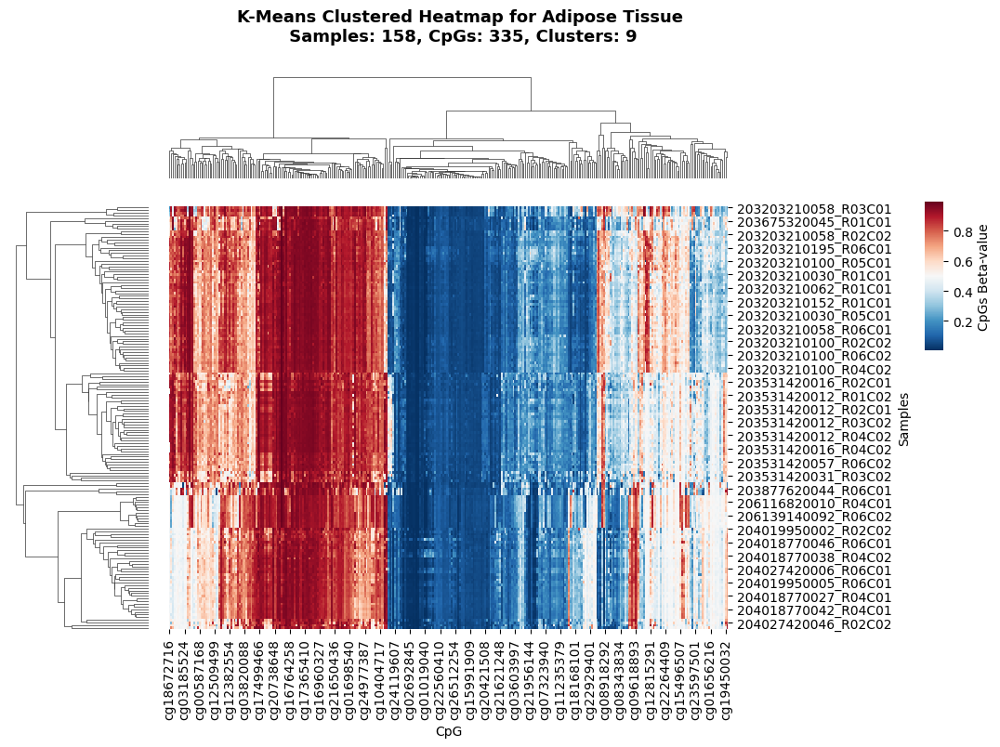

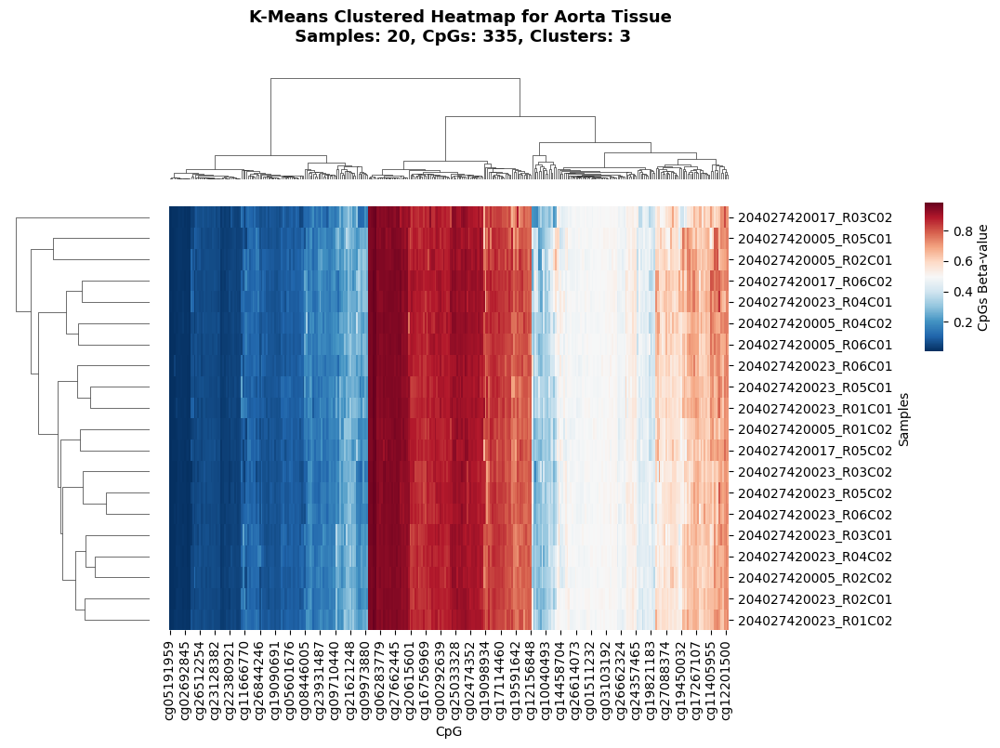

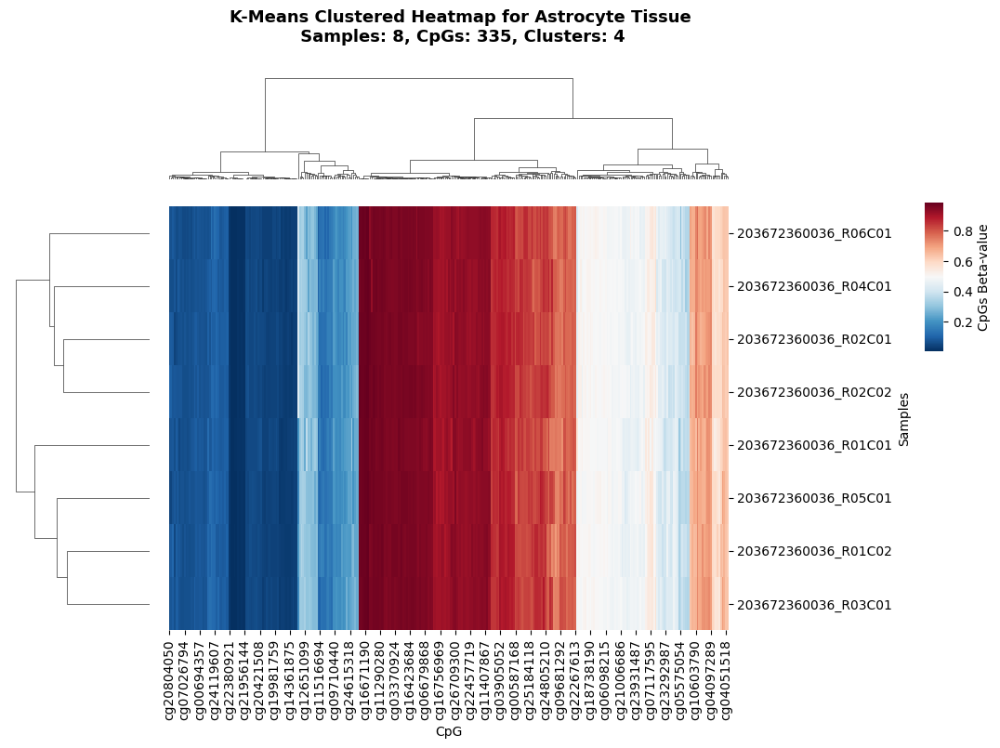

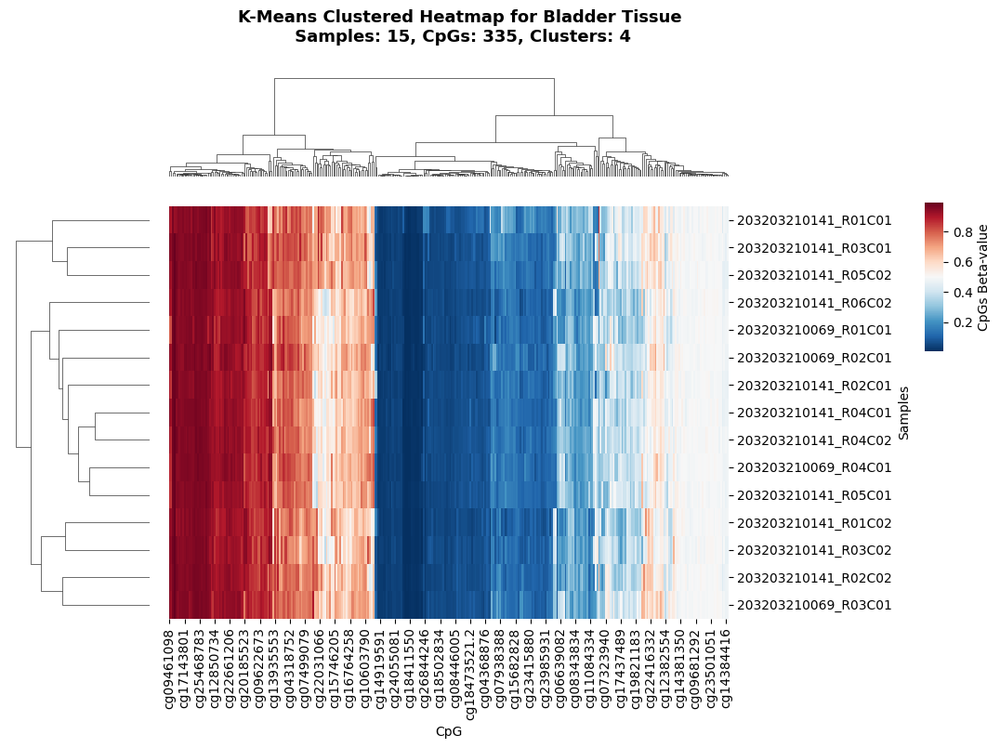

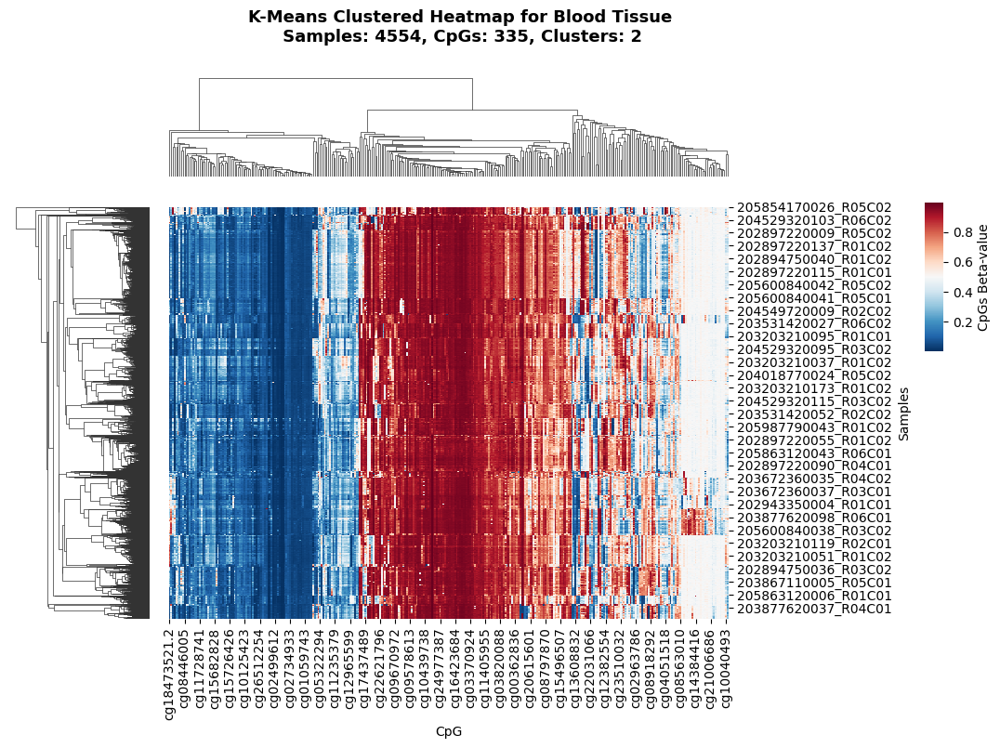

...

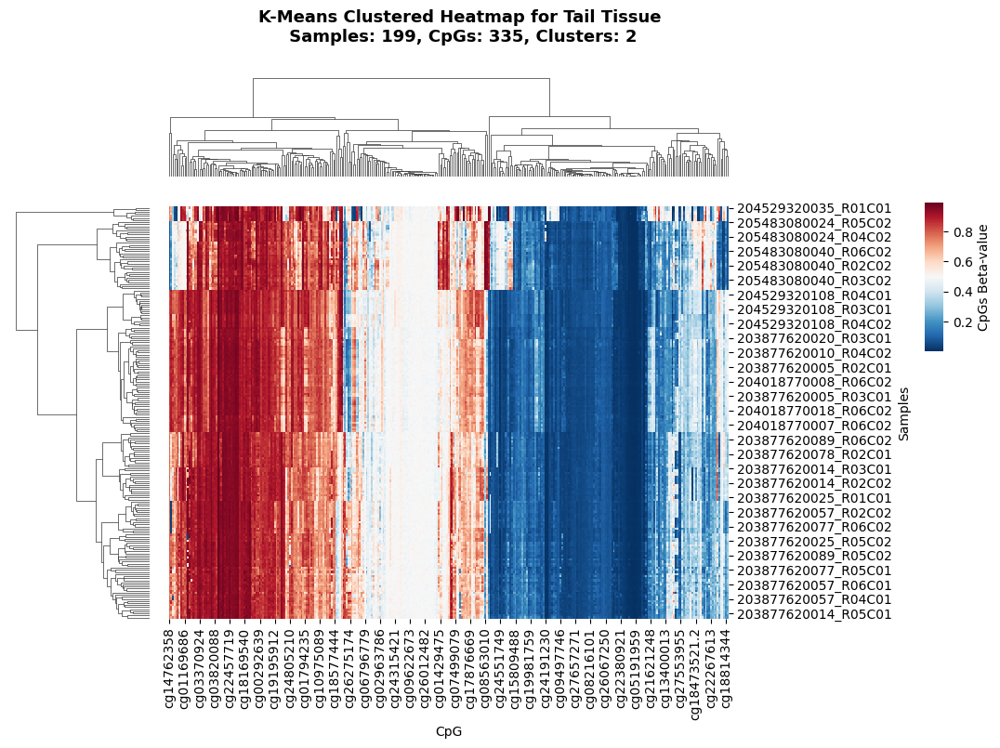

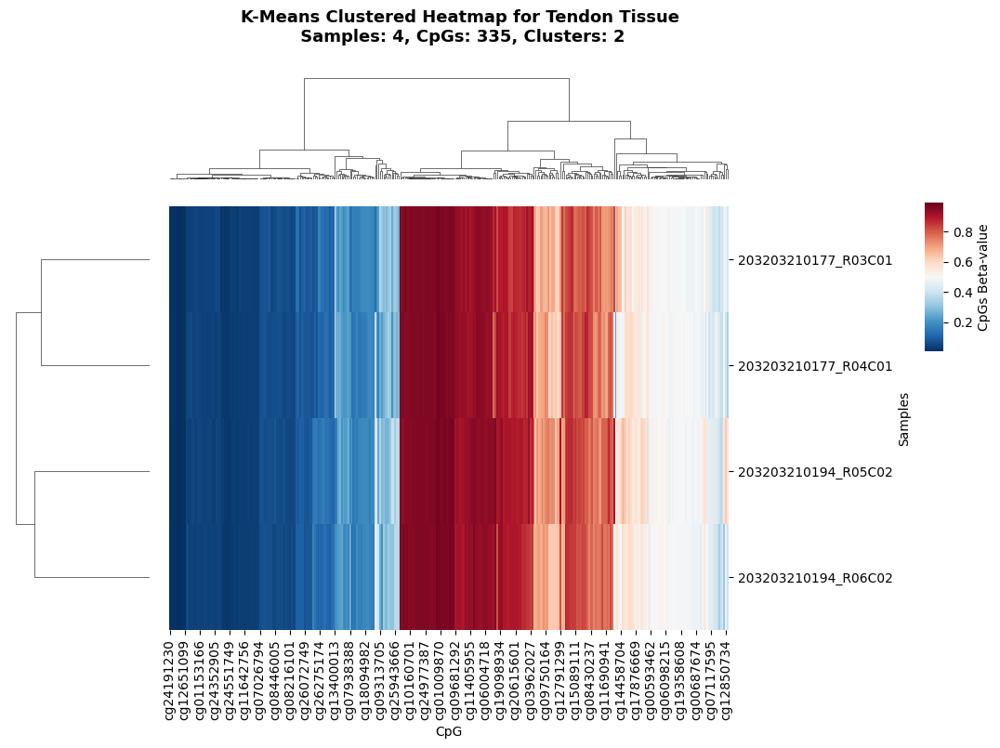

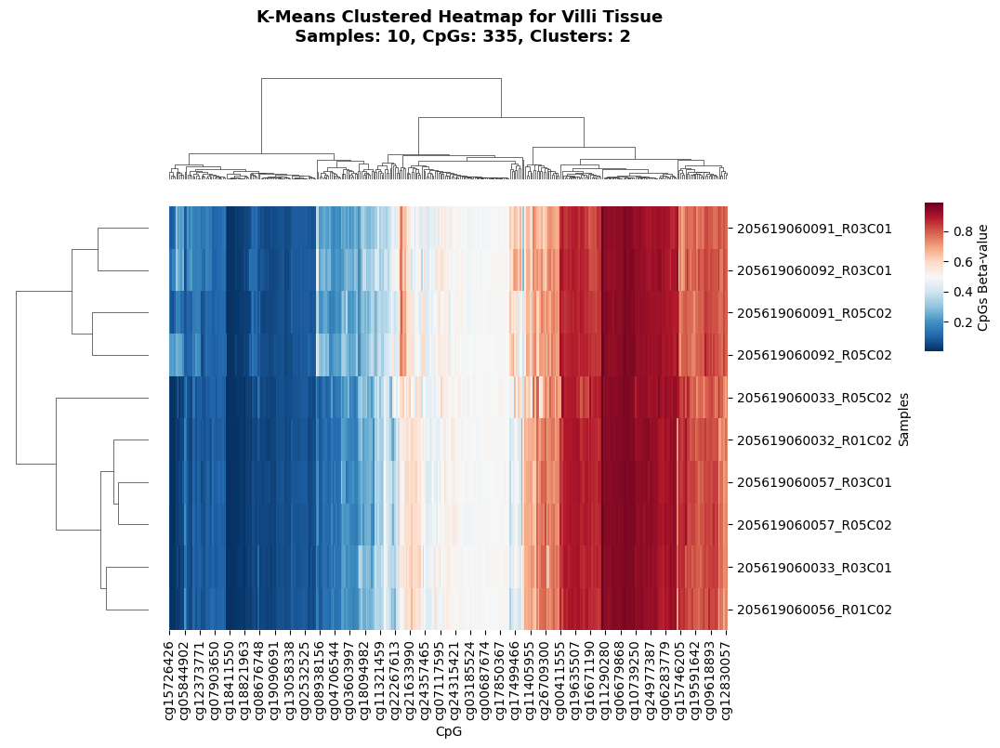

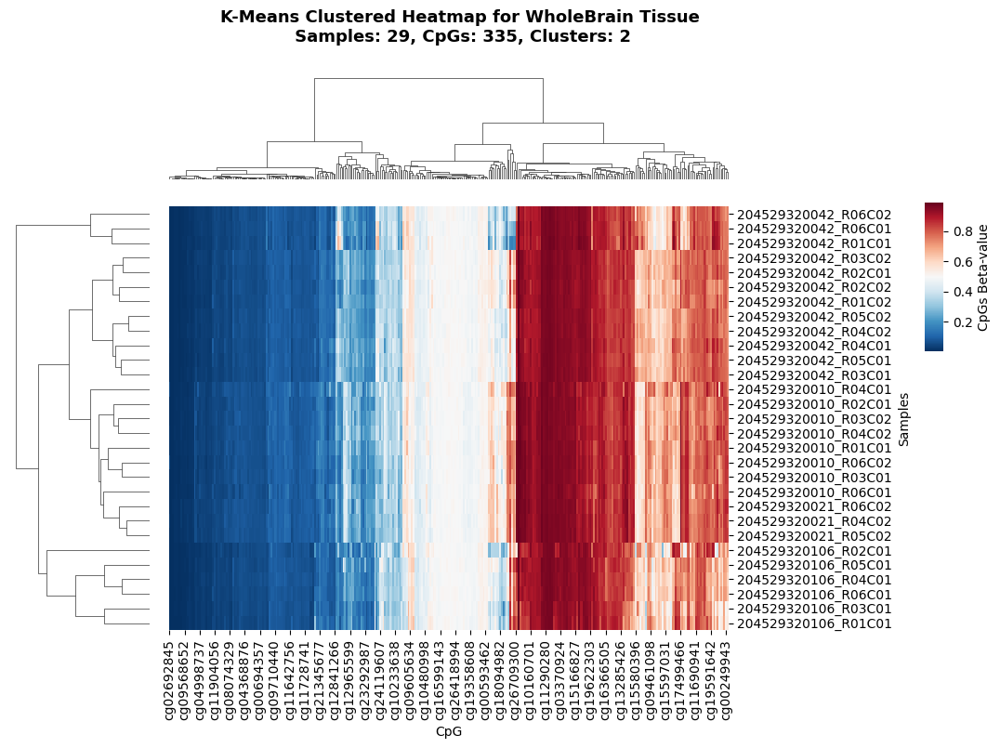

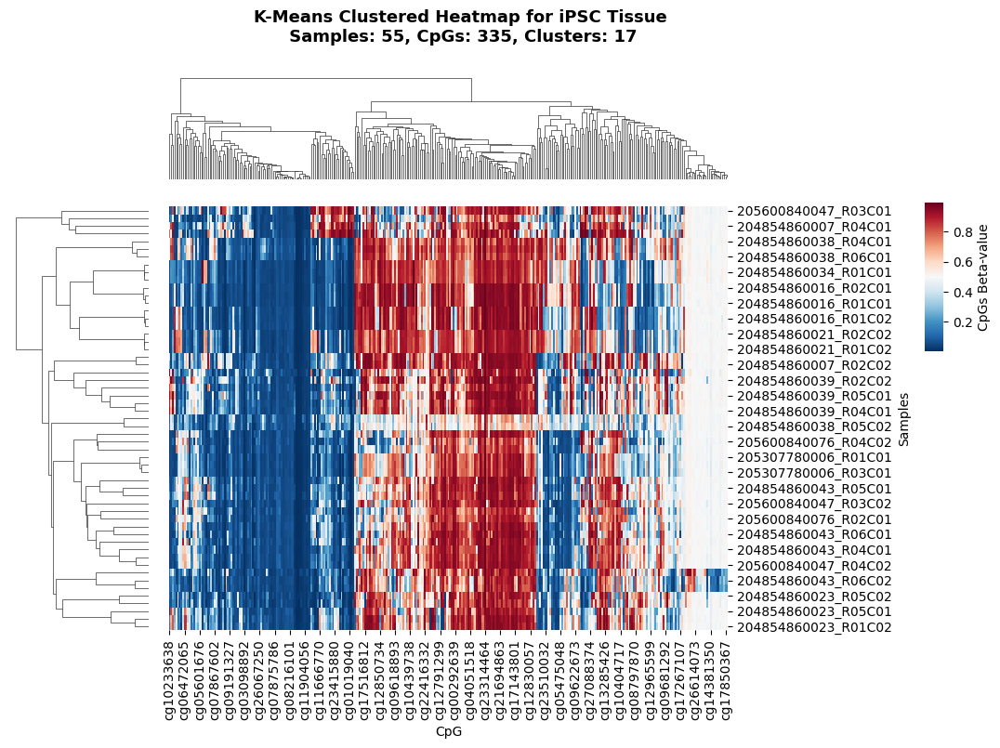

In [299]:
### Clustered Heatmaps & CpG exporting

# folder where to save the CpG clustering results
folder = './Cluster Analysis/Clustering Results/KM'

# Loop through the best K-means results for each tissue
for _, row in kmeans_best_results.iterrows(): # _ stands for the index of the row
    
    tissue_name = row['Tissue']
    k = row['k']
    labels = row['cluster_labels']
    
    # Get the tissue-specific dataset
    tissue_dataset = tissue_datasets.loc[tissue_datasets['Tissue'] == tissue_name, 'Dataset'].iloc[0]
    
    # Transpose the dataset so that CpGs are columns and samples are rows
    tissue_dataset = tissue_dataset.set_index('CpG').transpose()

    # Skip if tissue dataset is empty or smallet than 2 samples
    if tissue_dataset.shape[0] < 2:
        continue

    # Create the clustered heatmap
    # clustered_heatmaps_only(tissue_name, tissue_dataset, labels, 'K-Means')
    clustered_heatmaps_and_cpgs(tissue_name, tissue_dataset, labels, 'K-Means', folder)

In your case, the K-means clustering grouped the samples into 8 clusters based on their CpG profiles. However, when you performed hierarchical clustering on the CpGs, it found only 2 major clusters of CpGs that have similar methylation patterns across the 8 sample clusters. This outcome suggests that while the samples can be separated into 8 distinct groups based on their overall CpG profiles, the CpGs themselves may exhibit only two major patterns of co-methylation or co-expression across these sample clusters.

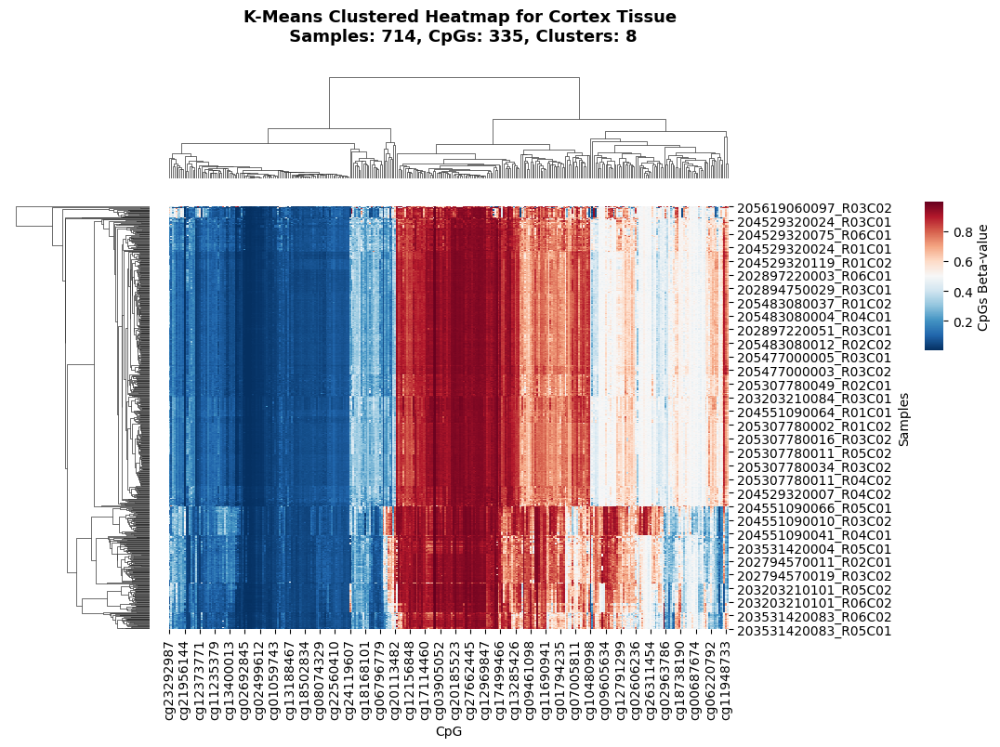

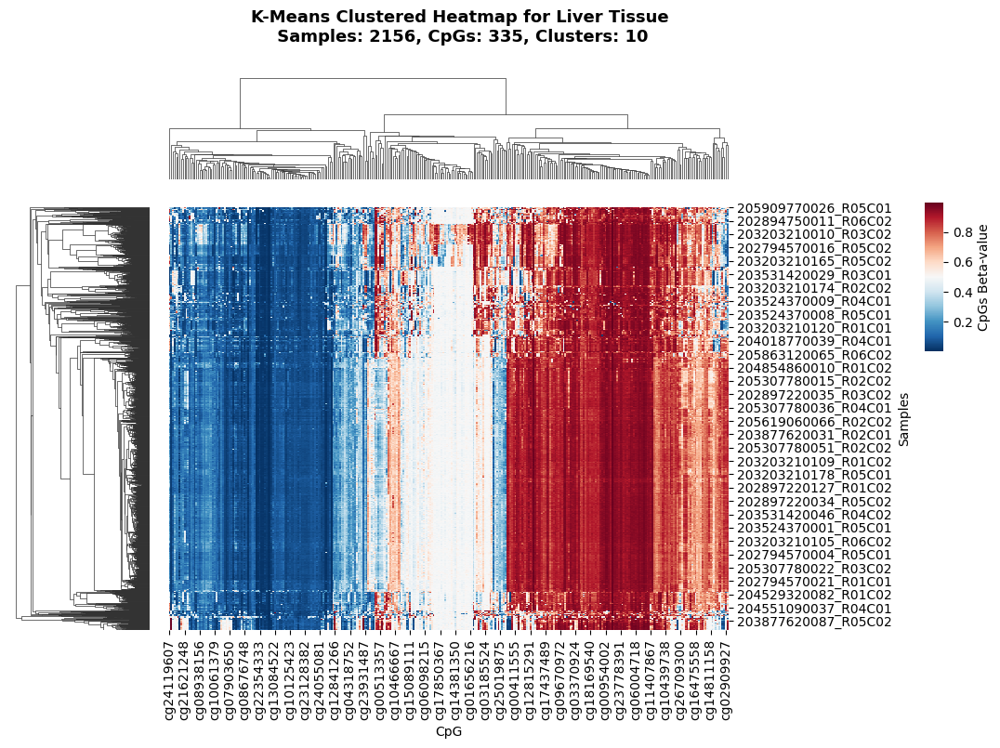

In [294]:
### Get list of CpGs associated to each cluster

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.cluster.hierarchy import fcluster

def clustered_heatmap_test(tissue_name, tissue_dataset, labels, model, folder):
    # Get the cluster labels
    labels = labels

    # Order the dataset based on the cluster labels
    ordered_dataset = tissue_dataset.copy()  # Make a copy of the dataset
    ordered_dataset['cluster'] = labels  # Add the cluster labels to the dataset
    n_clusters = len(ordered_dataset['cluster'].unique())  # Get the number of clusters
    ordered_dataset = ordered_dataset.sort_values(by='cluster')  # Sort by cluster
    ordered_dataset = ordered_dataset.drop(columns='cluster')

    # Create the clustermap
    g = sns.clustermap(ordered_dataset,  # dataset to plot
                       cmap='RdBu_r',  # color map
                       metric='euclidean',  # distance metric for clustering 
                       z_score=None,  # Z score the data
                       standard_scale=None,  # Standardize the data
                       figsize=(10, 8),  # Set figure size here
                       cbar_kws={'label': 'CpGs Beta-value', 'orientation': 'vertical'})  # Colorbar settings
    
    ## Extract the linkage matrix used by sns.clustermap
    linkage_matrix = g.dendrogram_col.linkage

    ## Calculate the distance threshold manually
    distance_threshold = 0.7 * np.max(linkage_matrix[:, 2]) # the distance threshold is set to 70% of the max distance in the linkage matrix. This choice of 70% is a value that is commonly used in practice.

    # Define a cutoff distance to form flat clusters
    cpg_clusters = fcluster(linkage_matrix, t=distance_threshold, criterion='distance')

    # Get CpG labels
    cpg_labels = ordered_dataset.columns

    # Create a DataFrame to see which CpGs are in which clusters
    cpg_cluster_df = pd.DataFrame({'CpG': cpg_labels, 'Cluster': cpg_clusters})

    # Move the title to the top of the figure
    plt.gcf().suptitle(f'{model} Clustered Heatmap for {tissue_name} Tissue\n Samples: {tissue_dataset.shape[0]}, CpGs: {tissue_dataset.shape[1]}, Clusters: {n_clusters}', 
                       fontsize=13, 
                       fontweight='bold', 
                       y=1  # Adjust the vertical position of the title, 0 is bottom, 1 is top
                       )

    # Add the label 'Samples' to the rows
    g.ax_heatmap.set_ylabel('Samples')

    # Adjust layout to add padding around the heatmap
    plt.gcf().tight_layout()

    # Manually adjust the position of the color bar to match the size of the heatmap
    g.cax.set_position([1, 0.54, 0.02, 0.20])  # [x, y, width, height]
  
    plt.show()

    # save the df in a csv 
    folder = folder
    os.makedirs(folder, exist_ok=True)
    filepath = os.path.join(folder, f'{tissue_name}_CpG_heatmap_clusters_{model}.csv')
    cpg_cluster_df.to_csv(filepath, index=False)

# set folder
folder = './Cluster Analysis/Clustering Results/KM'


# Loop through the best K-means results for each tissue
for _, row in kmeans_best_results.iterrows(): # _ stands for the index of the row
    
    tissue_name = row['Tissue']
    k = row['k']
    labels = row['cluster_labels']

    # Check that the tissue exists in tissue_datasets_test
    if tissue_name not in tissue_datasets_test['Tissue'].values:
        continue
    
    # Get the tissue-specific dataset
    tissue_dataset = tissue_datasets_test.loc[tissue_datasets_test['Tissue'] == tissue_name, 'Dataset'].iloc[0]
    
    # Transpose the dataset so that CpGs are columns and samples are rows
    tissue_dataset = tissue_dataset.set_index('CpG').transpose()

    # Skip if tissue dataset is empty or smallet than 2 samples
    if tissue_dataset.shape[0] < 2:
        continue

    # Create the clustered heatmap
    clustered_heatmap_test(tissue_name, tissue_dataset, labels, 'K-Means', folder)



In [289]:
cpg_cluster_df

,CpG,Cluster
0,cg00249943,2
1,cg00250826,2
2,cg00292639,2
3,cg00362836,2
4,cg00411555,2
...,...,...
330,cg27547112,2
331,cg27553955,1
332,cg27581159,1
333,cg27657271,1


In [292]:
# cpg_cluster_df[cpg_cluster_df['CpG']=="cg10125423"]
# cpg_cluster_df[cpg_cluster_df['CpG']=="cg23128382"]
# cpg_cluster_df[cpg_cluster_df['CpG']=="cg23778391"]

,CpG,Cluster
118,cg10125423,1


## 2. Hierarchical clustering analysis of all tissue datasets filtered by Clock1

In [208]:
#### HC loop for all tissue datasets - Sklearn

# Results dataframe
hc_results = pd.DataFrame(columns=['Tissue', 'Method', 'Metric', 'Cophonetic Correlation', 'Silhouette Score', 'Z', 'Cluster Labels'])

# Dendogram dictionary
HC_dendrograms = {}

# # Select only the first two datasets for testing
# tissue_datasets = tissue_datasets.head(2)

# Loop through all tissue datasets
for index, row in tissue_datasets.iterrows():
    tissue_name = row['Tissue']
    tissue_dataset = row['Dataset']

    # Select the data for clustering
    X = tissue_dataset.iloc[1:, 1:]

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    # Train the model and test different methods of linkage
    methods = ['single', 'complete', 'average', 'ward']

    metrics = ['euclidean', 'cityblock', 'cosine']
    
    for method in methods:

        for metric in metrics:

            # Add a exception for the ward method as it only used euclidean distance
            if method == 'ward' and metric != 'euclidean':
                continue

            # Perform hierarchical clustering with current parameters
            Z = linkage(X, method=method, metric=metric)

            # Save the Z so a dendrogram can be plotted later
            HC_dendrograms[tissue_name] = Z

            # Calculate Cophonetic Correlation
            coph_corr = cophenet(Z, pdist(X))[0]

            # Calculate Silhouette Score
            cluster_labels = fcluster(Z, t=len(Z)+1-2, criterion='maxclust') # Obtain cluster labels
            silhouette_avg = silhouette_score(X, cluster_labels) # Calculate silhouette score

            # Add results to result DataFrame
            hc_results.loc[len(hc_results)] = [tissue_name, method, metric, coph_corr, silhouette_avg, Z, cluster_labels]
# Print results
hc_results 

,Tissue,Method,Metric,Cophonetic Correlation,Silhouette Score,Z,Cluster Labels
0,Cortex,single,euclidean,0.470112,0.002078,"[[56.0, 223.0, 0.16120065286176735, 2.0], [32....","[194, 202, 215, 317, 307, 300, 267, 270, 53, 9..."
1,Cortex,single,cityblock,0.618715,0.004849,"[[56.0, 223.0, 3.7527967320367823, 2.0], [32.0...","[157, 193, 218, 327, 241, 312, 286, 276, 52, 8..."
2,Cortex,single,cosine,0.510179,0.002078,"[[56.0, 223.0, 3.417840216068946e-06, 2.0], [3...","[210, 214, 177, 299, 271, 321, 152, 1, 40, 80,..."
3,Cortex,complete,euclidean,0.830217,0.004849,"[[56.0, 223.0, 0.16120065286176735, 2.0], [32....","[161, 190, 174, 315, 204, 262, 253, 326, 72, 5..."
4,Cortex,complete,cityblock,0.825674,0.004849,"[[56.0, 223.0, 3.7527967320367823, 2.0], [32.0...","[266, 251, 210, 306, 322, 156, 175, 161, 84, 1..."
5,Cortex,complete,cosine,0.743842,0.002078,"[[56.0, 223.0, 3.417840216068946e-06, 2.0], [3...","[267, 261, 248, 181, 192, 7, 306, 147, 92, 72,..."
6,Cortex,average,euclidean,0.834704,0.004849,"[[56.0, 223.0, 0.16120065286176735, 2.0], [32....","[268, 258, 276, 320, 293, 160, 148, 176, 66, 2..."
7,Cortex,average,cityblock,0.832560,0.004849,"[[56.0, 223.0, 3.7527967320367823, 2.0], [32.0...","[143, 198, 150, 270, 221, 326, 302, 311, 57, 3..."
8,Cortex,average,cosine,0.797917,0.002078,"[[56.0, 223.0, 3.417840216068946e-06, 2.0], [3...","[230, 228, 212, 159, 177, 141, 147, 311, 82, 9..."
9,Cortex,ward,euclidean,0.825566,0.004849,"[[56.0, 223.0, 0.16120065286176735, 2.0], [32....","[278, 223, 276, 173, 303, 187, 179, 134, 51, 8..."


In [209]:
### HC best results: filtered clustering results for all tissues by best silhouette score 

# Group the results DataFrame by tissue and find the row with the highest cophenetic correlation value for each tissue
hc_best_results = hc_results.sort_values(by='Silhouette Score', ascending=False).groupby('Tissue').first().reset_index()
hc_best_results.sort_values(by='Silhouette Score', ascending=False)

,Tissue,Method,Metric,Cophonetic Correlation,Silhouette Score,Z,Cluster Labels
0,Cortex,ward,euclidean,0.825566,0.004849,"[[56.0, 223.0, 0.16120065286176735, 2.0], [32....","[278, 223, 276, 173, 303, 187, 179, 134, 51, 8..."
1,Liver,single,euclidean,0.537766,0.003614,"[[56.0, 223.0, 1.6227817511267038, 2.0], [160....","[170, 199, 230, 221, 321, 261, 246, 240, 30, 8..."


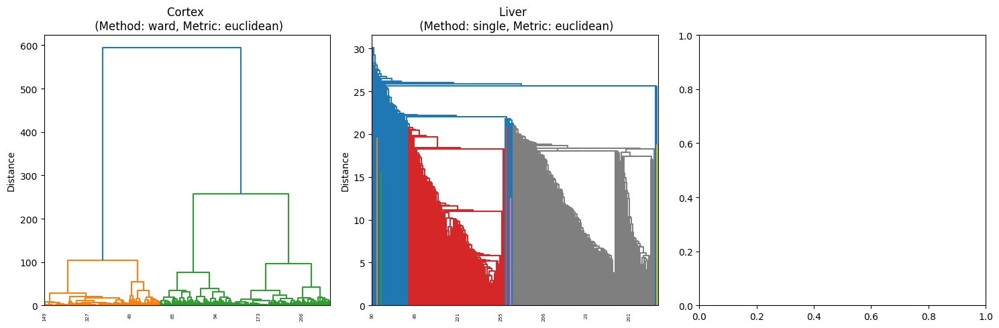

In [210]:
### Plot the dendograms for the results of the hierarchical clustering

# Create a figure with subplots for each tissue
num_tissues = len(tissue_datasets)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

# Create the figure and axes
fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Loop through all tissue datasets
for ax, (index, row) in zip(axs.flat, hc_best_results.iterrows()):
    tissue_name = row['Tissue']
    Z = row['Z']  # Get the linkage matrix from the best_results DataFrame

    # Plot the dendrogram
    dendrogram(Z, ax=ax)
    ax.set_title(f'{tissue_name} \n (Method: {row['Method']}, Metric: {row['Metric']})')
    # show only every 50 sample names
    ax.set_xticks(ax.get_xticks()[::50])
    ax.set_ylabel('Distance')
    # ax.grid()

# Adjust layout
plt.tight_layout()
plt.show()

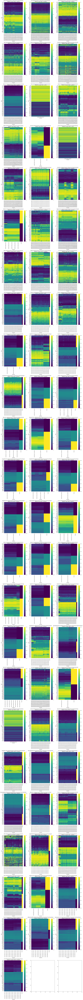

In [24]:
### Plot heatmaps for each tissue using the best results of the hierarchical clustering

# Create a figure with subplots for each tissue
num_tissues = len(tissue_datasets)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10*num_rows))

for tissue in hc_best_results['Tissue']:
    # Get the best linkage matrix for the current tissue
    Z = hc_best_results[hc_best_results['Tissue'] == tissue]['Z'].iloc[0]

    # Get the cluster labels
    cluster_labels = fcluster(Z, t=len(Z)+1-2, criterion='maxclust') # Obtain cluster labels

    # Get the data for the current tissue
    X = tissue_datasets[tissue_datasets['Tissue'] == tissue]['Dataset'].iloc[0].iloc[:, 1:]

    # Reorder the rows of X based on the cluster labels
    cluster_indices = np.argsort(cluster_labels)
    X_reordered = X.iloc[cluster_indices]

    # Plot the heatmap of the reordered X matrix
    ax = axs.flat[tissues.tolist().index(tissue)]
    sns.heatmap(X_reordered, cmap='viridis', ax=ax)
    ax.set_title(f'{tissue} Heatmap based on Hierarchical Clustering Results \n (Method: {hc_best_results[hc_best_results["Tissue"] == tissue]["Method"].iloc[0]}, Metric: {hc_best_results[hc_best_results["Tissue"] == tissue]["Metric"].iloc[0]})')
    ax.set_xlabel('Sampples')
    ax.set_ylabel('CpGs')
    # ax.grid()

# Adjust layout
plt.tight_layout()
plt.show()

In [25]:
### Get a list of CpGs in each cluster and save in a csv file

folder = './Cluster Analysis/Clustering Results/HC'
os.makedirs(folder, exist_ok=True)

# Create a dictionary to store the clustered CpGs for each tissue
HC_clustered_cpgs = {}

# Loop through all tissue datasets
for index, row in hc_best_results.iterrows():
    tissue_name = row['Tissue']
    Z = row['Z']

    # Get the cluster labels
    cluster_labels = fcluster(Z, t=len(Z)+1-2, criterion='maxclust')

    # Get the data for the current tissue
    tissue_dataset = tissue_datasets[tissue_datasets['Tissue'] == tissue_name]['Dataset'].iloc[0]

    # Get the list of CpGs in each cluster
    tissue_dataset['Cluster'] = cluster_labels
    HC_clustered_cpgs[tissue_name] = tissue_dataset[['CpG', 'Cluster']]

    # Save the clustered CpGs to a CSV file
    file_path = os.path.join(folder, f'{tissue_name}_methylation_dataset_Clock1_HC_clustered_CpGs.csv')
    tissue_dataset[['CpG', 'Cluster']].to_csv(file_path, index=False)


## . DBSCAN analysis of all tissue datasets filtered by Clock1

In [211]:
### DBSCAN loop for all tissue datasets  --- THIS ONE TAKES AGES TO RUN 145 min

# Results dataframe
dbscan_results = pd.DataFrame(columns=['Tissue', 'eps', 'min_samples', 'silhouette_score', 'n_clusters', 'core_samples'])

# Loop through all tissue datasets
for index, row in tissue_datasets.iterrows():
    tissue_name = row['Tissue']
    tissue_dataset = row['Dataset']

    # Select the data for clustering
    X = tissue_dataset.iloc[1:, 1:]

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    # Calculate the max distance between samples
    max_distance = np.max(squareform(pdist(X))) 

    # Train the model and test different values of epsilon and min_samples
    eps_values = np.arange(0.1 * max_distance, 1.1 * max_distance, 0.05) # The maximum distance between two samples for one to be considered as in the neighborhood of the other
    min_samples_values = range(2, 10) # Number of samples in a neighborhood for a point to be considered as a core point

    for eps in eps_values:

        for min_samples in min_samples_values:

            # Perform DBSCAN with current parameters
            dbscan = DBSCAN(eps=eps, min_samples=min_samples)

            # Fit the model to your data
            dbscan.fit(X)

            # Check the number of clusters
            n_clusters = len(set(dbscan.labels_)) - (1 if -1 in dbscan.labels_ else 0)

            # Check the number of core samples
            core_samples = np.zeros_like(dbscan.labels_, dtype=bool)
            core_samples[dbscan.core_sample_indices_] = True

            # Calculate Silhouette Score
            if n_clusters > 1:
                silhouette_avg = silhouette_score(X, dbscan.labels_)
            else:
                silhouette_avg = -1

            # Add results to result DataFrame
            dbscan_results.loc[len(dbscan_results)] = [tissue_name, eps, min_samples, silhouette_avg, n_clusters, core_samples]

# Print results
dbscan_results

,Tissue,eps,min_samples,silhouette_score,n_clusters,core_samples
0,Cortex,7.73407,2,-0.199991,3,"[True, True, True, False, True, True, True, Tr..."
1,Cortex,7.73407,3,-1.000000,1,"[True, True, True, False, False, True, True, T..."
2,Cortex,7.73407,4,-0.140197,2,"[True, True, True, False, False, True, True, T..."
3,Cortex,7.73407,5,-1.000000,1,"[True, True, True, False, False, True, True, T..."
4,Cortex,7.73407,6,-1.000000,1,"[True, True, True, False, False, True, True, T..."
...,...,...,...,...,...,...
33851,Liver,147.62007,5,-1.000000,1,"[True, True, True, True, True, True, True, Tru..."
33852,Liver,147.62007,6,-1.000000,1,"[True, True, True, True, True, True, True, Tru..."
33853,Liver,147.62007,7,-1.000000,1,"[True, True, True, True, True, True, True, Tru..."
33854,Liver,147.62007,8,-1.000000,1,"[True, True, True, True, True, True, True, Tru..."


In [212]:
### Best DBSCAN results: filtered data where the best silhouette score is used to select the best combination of epsilon and min_samples for each tissue

# Group the results DataFrame by tissue and find the row with the highest silhouette score value for each tissue
dbscan_best_results = dbscan_results.loc[dbscan_results.groupby('Tissue')['silhouette_score'].idxmax()]

# Reset index to make it cleaner
dbscan_best_results.reset_index(drop=True, inplace=True)
dbscan_best_results


,Tissue,eps,min_samples,silhouette_score,n_clusters,core_samples
0,Cortex,8.13407,9,0.485658,3,"[True, True, True, False, False, False, True, ..."
1,Liver,19.82007,9,0.377502,3,"[True, True, False, False, False, True, True, ..."


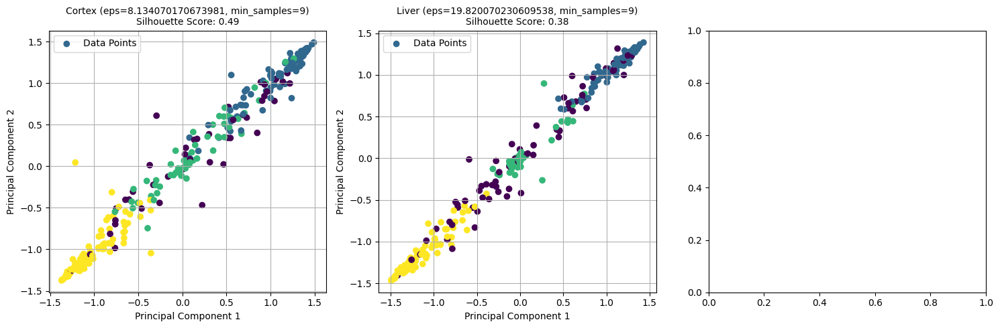

In [213]:
### Plot the DBSCAN clustering results for all tissues

# Create a figure with subplots for each tissue
num_tissues = len(tissue_datasets)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Loop through all tissue datasets
for ax, (index, row) in zip(axs.flat, dbscan_best_results.iterrows()):
    tissue_name = row['Tissue']
    eps = row['eps']
    min_samples = row['min_samples']

    # Get the data for the current tissue
    X = tissue_datasets[tissue_datasets['Tissue'] == tissue_name]['Dataset'].iloc[0].iloc[:, 1:]

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    # Perform DBSCAN with best parameters
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)

    # Fit the model to your data
    dbscan.fit(X)

    # Get the cluster labels
    labels = dbscan.labels_

    # Plot the data
    ax.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
    ax.set_title(f'{tissue_name} (eps={eps}, min_samples={min_samples})\nSilhouette Score: {row["silhouette_score"]:.2f}', size=10)
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.legend(['Data Points'])
    ax.grid()

# Adjust layout
plt.tight_layout()
plt.show()


C:\Users\Catia Antunes\AppData\Local\Temp\ipykernel_11872\2179100481.py:29: DeprecationWarning: Calling nonzero on 0d arrays is deprecated, as it behaves surprisingly. Use `atleast_1d(cond).nonzero()` if the old behavior was intended. If the context of this warning is of the form `arr[nonzero(cond)]`, just use `arr[cond]`.
  best_min_samples_idx = np.where(min_samples_values == best_min_samples)[0][0]


IndexError: index 0 is out of bounds for axis 0 with size 0

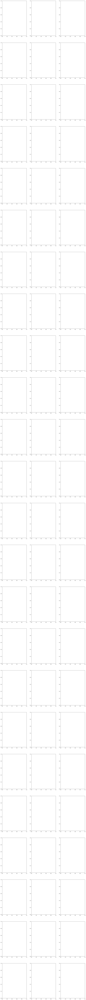

In [29]:
### Plot the heatmap for the DBSCAN clustering results

# Create a figure with subplots for each tissue
num_tissues = len(dbscan_best_results)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10*num_rows))

for idx, row in dbscan_best_results.iterrows():
    tissue = row['Tissue']
    best_eps = row['eps']
    best_min_samples = row['min_samples']
    
    # Get the core samples for the current tissue
    core_samples = tissue_datasets[tissue_datasets['Tissue'] == tissue]['Dataset'].iloc[0].iloc[:, 1:]
    
    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(core_samples)
    
    # Create a grid of min_samples values
    min_samples_values = range(2, 10)
    
    # Create a 2D grid of scores
    scores = np.zeros((len(min_samples_values), 1))
    
    # Set the score for the best parameters
    best_min_samples_idx = np.where(min_samples_values == best_min_samples)[0][0]
    scores[best_min_samples_idx, 0] = row['silhouette_score']
    
    # Plot the heatmap
    ax = axs[idx // num_cols, idx % num_cols]
    sns.heatmap(scores, xticklabels=[best_eps], yticklabels=min_samples_values, cmap='YlOrRd', ax=ax)
    ax.set_title(f"DBSCAN Silhouette Score Heatmap for {tissue}")
    ax.set_xlabel("Epsilon")
    ax.set_ylabel("Min Samples")
    ax.scatter(0, best_min_samples_idx, s=100, marker='x', color='black')

plt.tight_layout()
plt.show()



In [ ]:
### Save the clustered CpGs for each tissue in a CSV file

folder = './Cluster Analysis/Clustering Results/DBSCAN'
os.makedirs(folder, exist_ok=True)

# Create a dictionary to store the clustered CpGs for each tissue
dbscan_clustered_cpgs = {}

# Loop through all tissue datasets
for index, row in dbscan_best_results.iterrows():
    tissue_name = row['Tissue']
    eps = row['eps']
    min_samples = row['min_samples']

    # Get the data for the current tissue
    tissue_dataset = tissue_datasets[tissue_datasets['Tissue'] == tissue_name]['Dataset'].iloc[0]

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(tissue_dataset.iloc[:, 1:])

    # Perform DBSCAN with best parameters
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan.fit(X)

    # Get the cluster labels
    labels = dbscan.labels_

    # Get the list of CpGs in each cluster
    tissue_dataset['Cluster'] = labels
    clustered_cpgs = tissue_dataset[['CpG', 'Cluster']]

    # Save the clustered CpGs to a CSV file
    file_path = os.path.join(folder, f'{tissue_name}_dbscan_clustered_cpgs.csv')
    clustered_cpgs.to_csv(file_path, index=False)

## 5. COMPARING CLUSTERING APPROACHES

## 6. Comparing Clustering Results Across Tissues

-  Compare the clustering results (e.g., cluster centroids, cluster assignments) obtained from different tissue-specific datasets.
- Visualize the clustering patterns across tissues using heatmaps, dendrograms, or multidimensional scaling plots.
- Use techniques such as hierarchical clustering or k-means clustering to cluster tissues based on their clustering patterns.
- Calculate similarity or dissimilarity metrics (e.g., Jaccard similarity, Euclidean distance) between clustering results of different tissues to identify similarities and differences.
- Perform statistical tests (e.g., ANOVA, t-tests) to assess the significance of differences in clustering patterns across tissues.

### 6.1. Best method and param for EACH tissue dataset

In [41]:
# Comparing all methods for EACH tissue (so, best method and params for each tissue)

kmeans_df = kmeans_best_results.copy()

hc_df = hc_best_results.copy()

dbscan_df = dbscan_best_results.copy()

# Initialize a results dataframe
best_method_tissue_results = pd.DataFrame(columns=['Tissue', 'Best Method', 'Parameters', 'Silhouette Score'])

# Iterate through each tissue and find the best method
for tissue in kmeans_df['Tissue']:
    kmeans_score = kmeans_df.loc[kmeans_df['Tissue'] == tissue, 'silhouette_score'].values[0]
    hc_score = hc_df.loc[hc_df['Tissue'] == tissue, 'Silhouette Score'].values[0]
    dbscan_score = dbscan_df.loc[dbscan_df['Tissue'] == tissue, 'silhouette_score'].values[0]

    if kmeans_score >= hc_score and kmeans_score >= dbscan_score:
        best_method = 'KMeans'
        params = {
            'k': kmeans_df.loc[kmeans_df['Tissue'] == tissue, 'k'].values[0],
            'cluster_centers': kmeans_df.loc[kmeans_df['Tissue'] == tissue, 'cluster_centers'].values[0]
        }
        best_score = kmeans_score
    elif hc_score >= kmeans_score and hc_score >= dbscan_score:
        best_method = 'Hierarchical'
        params = {
            'Method': hc_df.loc[hc_df['Tissue'] == tissue, 'Method'].values[0],
            'Metric': hc_df.loc[hc_df['Tissue'] == tissue, 'Metric'].values[0]
        }
        best_score = hc_score
    else:
        best_method = 'DBSCAN'
        params = {
            'eps': dbscan_df.loc[dbscan_df['Tissue'] == tissue, 'eps'].values[0],
            'min_samples': dbscan_df.loc[dbscan_df['Tissue'] == tissue, 'min_samples'].values[0]
        }
        best_score = dbscan_score

    # Append to results dataframe
    best_method_tissue_results.loc[len(best_method_tissue_results)] = [tissue, best_method, params, best_score]

best_method_tissue_results


,Tissue,Best Method,Parameters,Silhouette Score
0,Adipose,KMeans,"{'k': 2, 'cluster_centers': [[0.82433311925219...",0.586453
1,AdrenalCortex,KMeans,"{'k': 3, 'cluster_centers': [[-1.0812668365600...",0.702481
2,Aorta,KMeans,"{'k': 3, 'cluster_centers': [[0.10255909234886...",0.699093
3,Astrocyte,KMeans,"{'k': 3, 'cluster_centers': [[-0.1660037582882...",0.727061
4,Bladder,KMeans,"{'k': 3, 'cluster_centers': [[0.10875305554344...",0.625494
...,...,...,...,...
65,Thyroid,DBSCAN,"{'eps': 0.35023417738496443, 'min_samples': 2}",0.813659
66,Uterus,DBSCAN,"{'eps': 0.5551422858876799, 'min_samples': 2}",0.710987
67,Villi,KMeans,"{'k': 3, 'cluster_centers': [[0.06400382421216...",0.694856
68,WholeBrain,KMeans,"{'k': 3, 'cluster_centers': [[0.11412186034461...",0.657762


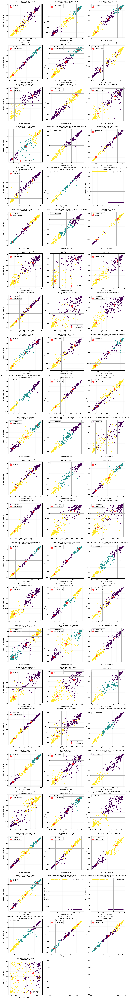

In [42]:
# Plot the results of the best clustering method for each tissue

# Create a figure with subplots for each tissue
num_tissues = len(tissue_datasets)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Loop through all tissue datasets
for ax, (index, row) in zip(axs.flat, best_method_tissue_results.iterrows()):
    tissue_name = row['Tissue']
    best_method = row['Best Method']
    params = row['Parameters']

    # Get the data for the current tissue
    X = tissue_datasets[tissue_datasets['Tissue'] == tissue_name]['Dataset'].iloc[0].iloc[:, 1:]

    # Standardize the data
    sc = StandardScaler()
    X = sc.fit_transform(X)

    if best_method == 'KMeans':
        # Initialize k-means clustering with n clusters
        kmeans = KMeans(params['k'], random_state=42)

        # Fit the model to your data
        kmeans.fit(X)

        # Get the cluster labels
        labels = kmeans.labels_

        # Get the cluster centers
        centers = kmeans.cluster_centers_

        # Plot the data
        ax.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
        ax.scatter(centers[:, 0], centers[:, 1], c='red', s=200, alpha=0.75)
        ax.set_title(f'{tissue_name} (KMeans with {params["k"]} clusters)\nSilhouette Score: {row["Silhouette Score"]:.2f}', size=10)
        ax.set_xlabel('Principal Component 1')
        ax.set_ylabel('Principal Component 2')
        ax.legend(['Data Points', 'Cluster Centers'])
        ax.grid()

    elif best_method == 'Hierarchical':
        # Perform hierarchical clustering with current parameters
        Z = linkage(X, method=params['Method'], metric=params['Metric'])

        # Get the cluster labels
        cluster_labels = fcluster(Z, t=len(Z)+1-2, criterion='maxclust')

        # Plot the data
        ax.scatter(X[:, 0], X[:, 1], c=cluster_labels, cmap='viridis')
        ax.set_title(f'{tissue_name} (Hierarchical Clustering)\nSilhouette Score: {row["Silhouette Score"]:.2f}', size=10)
        ax.set_xlabel('Principal Component 1')
        ax.set_ylabel('Principal Component 2')
        ax.legend(['Data Points'])
        ax.grid()

    else:
        # Perform DBSCAN with best parameters
        dbscan = DBSCAN(eps=params['eps'], min_samples=params['min_samples'])

        # Fit the model to your data
        dbscan.fit(X)

        # Get the cluster labels
        labels = dbscan.labels_

        # Plot the data
        ax.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
        ax.set_title(f'{tissue_name} (DBSCAN with eps={params["eps"]}, min_samples={params["min_samples"]})\nSilhouette Score: {row["Silhouette Score"]:.2f}', size=10)
        ax.set_xlabel('Principal Component 1')
        ax.set_ylabel('Principal Component 2')
        ax.legend(['Data Points'])
        ax.grid()

# Adjust layout
plt.tight_layout()
plt.show()
    


### 6.2. Best method and param for ALL tissue datasets (overall)

In [214]:
# Comparing all methods for ALL tissues (so, best method and params overall)

kmeans_df = kmeans_best_results.copy()

hc_df = hc_best_results.copy()

dbscan_df = dbscan_best_results.copy()


# Calculate average silhouette scores
kmeans_avg_score = kmeans_df['silhouette_score'].mean()
hc_avg_score = hc_df['Silhouette Score'].mean()
dbscan_avg_score = dbscan_df['silhouette_score'].mean()

# Store the results in a dictionary
avg_scores = {
    'KMeans': kmeans_avg_score,
    'Hierarchical': hc_avg_score,
    'DBSCAN': dbscan_avg_score
}

# Find the best method based on average silhouette score
best_method = max(avg_scores, key=avg_scores.get)
best_score = avg_scores[best_method]

print(f"The best method overall is {best_method} with an average silhouette score of {best_score:.6f}")

The best method overall is KMeans with an average silhouette score of 0.592068


In [215]:
# Best K for KMeans for each tissue
kmeans_best_results['k'] = kmeans_best_results['k'].astype(int)

# Find the best K for KMeans
best_kmeans_k = kmeans_best_results['k'].mode()[0]

print(f"The best overall K for KMeans is {best_kmeans_k}")

The best overall K for KMeans is 2


### 6.3. Jaccard similarity & Euclidean distance between tissues

In [216]:
# Calculate the similarity & distance between the clustering results of the best method (KMeans) between tissues

# Select the Tissue and cluster_labels columns from the best KMeans results
kmeans_df = kmeans_best_results[['Tissue', 'cluster_labels']]

# Initialize an empty dataframe to store pairwise similarity/dissimilarity results
similarity_results = pd.DataFrame(columns=['Tissue1', 'Tissue2', 'Jaccard Similarity', 'Euclidean Distance'])

# Get all combinations of tissue pairs
tissue_pairs = list(combinations(kmeans_df['Tissue'], 2))

# Calculate similarity/dissimilarity metrics for each pair
for tissue1, tissue2 in tissue_pairs:
    labels1 = kmeans_df.loc[kmeans_df['Tissue'] == tissue1, 'cluster_labels'].values[0]
    labels2 = kmeans_df.loc[kmeans_df['Tissue'] == tissue2, 'cluster_labels'].values[0]
    
    # Ensure both label sets have the same length
    min_len = min(len(labels1), len(labels2))
    labels1 = labels1[:min_len]
    labels2 = labels2[:min_len]
    
    # Calculate Jaccard similarity
    jaccard_sim = jaccard_score(labels1, labels2, average='macro')
    
    # Calculate Euclidean distance
    euclidean_dist = euclidean(labels1, labels2)
    
    # Append results to the dataframe
    similarity_results.loc[len(similarity_results)] = [tissue1, tissue2, jaccard_sim, euclidean_dist]

similarity_results


,Tissue1,Tissue2,Jaccard Similarity,Euclidean Distance
0,Cortex,Liver,0.026001,17.804494


In [51]:
# Check max and min of Jaccard Similarity and Euclidean Distance
max_jaccard = similarity_results['Jaccard Similarity'].max()
min_jaccard = similarity_results['Jaccard Similarity'].min()
max_euclidean = similarity_results['Euclidean Distance'].max()
min_euclidean = similarity_results['Euclidean Distance'].min()

print(f"Max Jaccard Similarity: {max_jaccard:.6f}")
print(f"Min Jaccard Similarity: {min_jaccard:.6f}")
print(f"Max Euclidean Distance: {max_euclidean:.6f}")
print(f"Min Euclidean Distance: {min_euclidean:.6f}")

Max Jaccard Similarity: 0.952212
Min Jaccard Similarity: 0.005779
Max Euclidean Distance: 27.820855
Min Euclidean Distance: 2.828427


#### Jaccard Similarity

The Jaccard similarity coefficient (or Jaccard index) measures the similarity between two sets of data. It is defined as the size of the intersection divided by the size of the union of the sets. In the context of clustering labels, it measures how similar the clustering results are between two tissues.

    Range: 0 to 1
        0: No similarity (the clusters are completely different).
        1: Perfect similarity (the clusters are exactly the same).


#### Euclidean Distance

The Euclidean distance is a measure of the true straight line distance between two points in Euclidean space. When comparing clustering labels, it provides a measure of how different the labels are in terms of their numeric values.

    Range: 0 to infinity
        0: No difference (the clusters are exactly the same).
        Higher values indicate greater dissimilarity.

### 6.4. Most Similar Tissues based on Jaccard similarity & Euclidean distance of clustering results

In [217]:
# Filter the similar tissues based on the calculated thresholds

# Define thresholds for significant similarities and distances
jaccard_threshold = 0.75  # Example threshold for high similarity. This value may need to be adjusted based on the data.
euclidean_threshold = 5.0  # Example threshold for low distance. This value may need to be adjusted based on the data.

# Filter the results
significant_similarities = similarity_results[similarity_results['Jaccard Similarity'] >= jaccard_threshold]
significant_distances = similarity_results[similarity_results['Euclidean Distance'] <= euclidean_threshold]

significant_similarities


,Tissue1,Tissue2,Jaccard Similarity,Euclidean Distance


In [ ]:
# Plot bar graph the similarity results

import matplotlib.pyplot as plt
from matplotlib import colormaps as mcolors


# Create a figure with subplots for each tissue
num_tissues = len(tissues)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Get a color from the 'viridis' colormap
viridis = mcolors.get_cmap('viridis')


# Loop through all tissue datasets
for ax, tissue in zip(axs.flat, tissues):
    # Get the similarity results for the current tissue
    tissue_results = significant_similarities[(significant_similarities['Tissue1'] == tissue) | (significant_similarities['Tissue2'] == tissue)]

    # Remove the current tissue from the results
    tissue_results = tissue_results[tissue_results['Tissue2'] != tissue]

    # Get the number of bars
    num_bars = len(tissue_results)
    
    # Create a list of colors from the 'viridis' colormap
    if num_bars == 1:
        bar_colors = [viridis(0.5)]  # Assign a single color (middle of the colormap)
    else:
        bar_colors = [viridis(i / (num_bars - 1)) for i in range(num_bars)]
    
    # Plot the Jaccard Similarity
    ax.bar(tissue_results['Tissue2'], tissue_results['Jaccard Similarity'], color=bar_colors)
    ax.set_title(f'{tissue} Jaccard Similarity with Other Tissues')
    ax.set_xlabel('Tissue')
    ax.set_ylabel('Jaccard Similarity')
    ax.set_ylim(0, 1)
    ax.grid()

    # Rotate the x-axis labels
    plt.sca(ax)
    plt.xticks(rotation=45, ha='right')

# remove unused subplots
for i in range(len(tissues), num_cols * num_rows):
    axs.flat[i].set_visible(False)

# Adjust layout
plt.tight_layout()
plt.show()

In [218]:
significant_similarities[significant_similarities['Tissue1'] == 'Fibroblast']

,Tissue1,Tissue2,Jaccard Similarity,Euclidean Distance


In [219]:
significant_similarities[significant_similarities['Tissue1'] == 'Skin']

,Tissue1,Tissue2,Jaccard Similarity,Euclidean Distance


The reason why the similarity between Fibroblast and Skin appears in one direction but not the other is due to the way the Jaccard similarity is calculated. 
When you calculate the Jaccard similarity between Fibroblast and Skin, you're essentially measuring how much of the Fibroblast cluster labels overlap with the Skin cluster labels. And when you calculate the Jaccard similarity between Skin and Fibroblast, you're measuring how much of the Skin cluster labels overlap with the Fibroblast cluster labels.

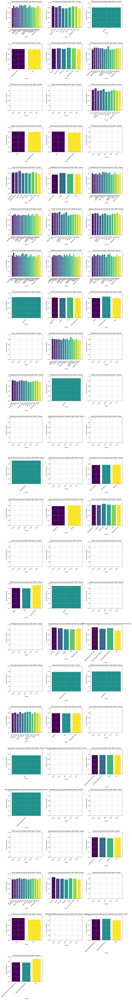

In [89]:
# Plot bar graph the similarity results

import matplotlib.pyplot as plt
from matplotlib import colormaps as mcolors


# Create a figure with subplots for each tissue
num_tissues = len(tissues)
num_cols = 3  # Adjust the number of columns as needed
num_rows = (num_tissues - 1) // num_cols + 1

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

# Get a color from the 'viridis' colormap
viridis = mcolors.get_cmap('viridis')


# Loop through all tissue datasets
for ax, tissue in zip(axs.flat, tissues):
    # Get the similarity results for the current tissue
    tissue_results = significant_similarities[(significant_similarities['Tissue1'] == tissue) | (significant_similarities['Tissue2'] == tissue)]

    # Remove the current tissue from the results
    tissue_results = tissue_results[tissue_results['Tissue2'] != tissue]

    # Get the number of bars
    num_bars = len(tissue_results)
    
    # Create a list of colors from the 'viridis' colormap
    if num_bars == 1:
        bar_colors = [viridis(0.5)]  # Assign a single color (middle of the colormap)
    else:
        bar_colors = [viridis(i / (num_bars - 1)) for i in range(num_bars)]
    
    # Plot the Jaccard Similarity
    ax.bar(tissue_results['Tissue2'], tissue_results['Jaccard Similarity'], color=bar_colors)
    ax.set_title(f'{tissue} Jaccard Similarity with Other Tissues')
    ax.set_xlabel('Tissue')
    ax.set_ylabel('Jaccard Similarity')
    ax.set_ylim(0, 1)
    ax.grid()

    # Rotate the x-axis labels
    plt.sca(ax)
    plt.xticks(rotation=45, ha='right')

# remove unused subplots
for i in range(len(tissues), num_cols * num_rows):
    axs.flat[i].set_visible(False)

# Adjust layout
plt.tight_layout()
plt.show()

### 6.5. Statistical tests (ANOVA) of significance differences in clustering patterns across tissues

In [128]:
# ANOVA test for comparing clustering patterns across different tissues - LABELS (ANOVA on cluster labels would test whether there is a significant difference in the clustering patterns or assignments across different tissues.)

# Select the Tissue and cluster_labels columns from the best KMeans results
kmeans_df = kmeans_best_results[['Tissue', 'cluster_labels']]

# Initialize an empty dataframe to store pairwise ANOVA results
anova_results = pd.DataFrame(columns=['Tissue1', 'Tissue2', 'F-Statistic', 'P-Value', 'Significant'])

# Get all combinations of tissue pairs
tissue_pairs = list(combinations(kmeans_df['Tissue'], 2))

# Set the significance level for the Bonferroni correction
alpha = 0.05

# Perform ANOVA test for each pair
for tissue1, tissue2 in tissue_pairs:
    labels1 = kmeans_df.loc[kmeans_df['Tissue'] == tissue1, 'cluster_labels'].values[0]
    labels2 = kmeans_df.loc[kmeans_df['Tissue'] == tissue2, 'cluster_labels'].values[0]
    
    # Ensure both label sets have the same length
    min_len = min(len(labels1), len(labels2))
    labels1 = labels1[:min_len]
    labels2 = labels2[:min_len]
    
    # Perform ANOVA test
    f_stat, p_val = f_oneway(labels1, labels2)
    
    # Adjust p-value using Bonferroni correction (multiply by the number of tests so that the family-wise error rate is controlled)
    corrected_p_val = p_val * len(tissue_pairs)
    
    # Determine if the difference is significant based on the adjusted p-value
    significant = corrected_p_val < alpha
    
    # Append results to the dataframe
    anova_results.loc[len(anova_results)] = [tissue1, tissue2, f_stat, corrected_p_val, significant]

anova_results


,Tissue1,Tissue2,F-Statistic,P-Value,Significant
0,Adipose,AdrenalCortex,61.819281,3.656172e-11,True
1,Adipose,Aorta,116.243599,1.027801e-21,True
2,Adipose,Astrocyte,129.479607,3.670962e-24,True
3,Adipose,Bladder,106.560280,6.760174e-20,True
4,Adipose,Blood,0.053698,1.972621e+03,False
...,...,...,...,...,...
2410,Uterus,WholeBrain,7.601077,1.447229e+01,False
2411,Uterus,iPSC,54.312601,1.223789e-09,True
2412,Villi,WholeBrain,1.117196,7.025360e+02,False
2413,Villi,iPSC,146.113404,3.539724e-27,True


In [129]:
# Filter the significant ANOVA results
alpha = 0.05

# Filter the results
significant_anova = anova_results[anova_results['P-Value'] < alpha]
significant_anova

,Tissue1,Tissue2,F-Statistic,P-Value,Significant
0,Adipose,AdrenalCortex,61.819281,3.656172e-11,True
1,Adipose,Aorta,116.243599,1.027801e-21,True
2,Adipose,Astrocyte,129.479607,3.670962e-24,True
3,Adipose,Bladder,106.560280,6.760174e-20,True
8,Adipose,Cartilage,67.291969,2.904690e-12,True
...,...,...,...,...,...
2405,Thyroid,Uterus,23.133718,4.513676e-03,True
2408,Thyroid,iPSC,184.013414,8.109850e-34,True
2411,Uterus,iPSC,54.312601,1.223789e-09,True
2413,Villi,iPSC,146.113404,3.539724e-27,True


In [130]:
# Filter the non-significant ANOVA results

non_significant_anova = anova_results[anova_results['P-Value'] >= alpha]
non_significant_anova

,Tissue1,Tissue2,F-Statistic,P-Value,Significant
4,Adipose,Blood,0.053698,1972.621373,False
5,Adipose,Blubber,2.183916,337.932262,False
6,Adipose,BoneMarrow,0.095442,1829.279450,False
7,Adipose,Brain,1.355960,590.840914,False
9,Adipose,Cecum,6.966620,20.523107,False
...,...,...,...,...,...
2406,Thyroid,Villi,0.945787,799.717548,False
2407,Thyroid,WholeBrain,4.211167,97.923193,False
2409,Uterus,Villi,14.330151,0.403760,False
2410,Uterus,WholeBrain,7.601077,14.472288,False


In [133]:
# ANOVA results for fibroblast
anova_results[anova_results['Tissue1'] == 'Fibroblast']

,Tissue1,Tissue2,F-Statistic,P-Value,Significant
1287,Fibroblast,FrontalCortex,9.684668e-02,1.825122e+03,False
1288,Fibroblast,Gut,1.649767e+02,1.604333e-30,True
1289,Fibroblast,Heart,5.420123e-02,1.970589e+03,False
1290,Fibroblast,HematopoieticStem.Progenitor.LSK,1.621215e+02,5.085783e-30,True
1291,Fibroblast,HematopoieticStemCells,1.587704e+02,1.980186e-29,True
1292,Fibroblast,Hippocampus,9.684668e-02,1.825122e+03,False
1293,Fibroblast,Hypothalamus,1.342051e+01,6.486765e-01,False
1294,Fibroblast,Ileum,7.253555e+01,2.618360e-13,True
1295,Fibroblast,Jejunum,1.175417e+02,5.888460e-22,True
1296,Fibroblast,Keratinocyte,6.547723e+00,2.589147e+01,False


In [131]:
# Non-significant ANOVA results for Fibroblast
non_significant_anova[non_significant_anova['Tissue1'] == 'Fibroblast']

,Tissue1,Tissue2,F-Statistic,P-Value,Significant
1287,Fibroblast,FrontalCortex,0.096847,1825.122132,False
1289,Fibroblast,Heart,0.054201,1970.589392,False
1292,Fibroblast,Hippocampus,0.096847,1825.122132,False
1293,Fibroblast,Hypothalamus,13.420511,0.648677,False
1296,Fibroblast,Keratinocyte,6.547723,25.891469,False
1297,Fibroblast,Kidney,0.294480,1418.921353,False
1300,Fibroblast,Liver,1.569687,508.818382,False
1301,Fibroblast,Lung,0.054201,1970.589392,False
1302,Fibroblast,LymphNode,0.024172,2116.734008,False
1306,Fibroblast,Maybe.Larynx,0.492607,1166.471444,False


In [132]:
# Significant ANOVA results for Fibroblast
significant_anova[significant_anova['Tissue1'] == 'Fibroblast']

,Tissue1,Tissue2,F-Statistic,P-Value,Significant
1288,Fibroblast,Gut,164.976679,1.604333e-30,True
1290,Fibroblast,HematopoieticStem.Progenitor.LSK,162.121451,5.085783e-30,True
1291,Fibroblast,HematopoieticStemCells,158.770387,1.980186e-29,True
1294,Fibroblast,Ileum,72.535554,2.618360e-13,True
1295,Fibroblast,Jejunum,117.541674,5.888460e-22,True
1298,Fibroblast,Lamina,77.309610,2.977148e-14,True
1299,Fibroblast,Larynx,90.022067,9.814994e-17,True
1303,Fibroblast,MacrophageBoneMarrow,175.690835,2.191284e-32,True
1304,Fibroblast,MacrophagePeritoneal,178.966532,5.963182e-33,True
1305,Fibroblast,Mammary,113.204171,3.801812e-21,True


## 7. Feature Importance Analysis

Conduct a feature importance analysis to identify CpGs that contribute the most to the clustering patterns in each tissue. You can use techniques such as feature importance scores from clustering algorithms or traditional feature selection methods like recursive feature elimination.

To conduct a feature importance analysis on your KMeans clustering results to identify CpGs that contribute the most to the clustering patterns in each tissue, you can follow these steps:

    Prepare Data:
        Ensure you have your data matrix (CpG sites as features and samples as rows) and the clustering labels obtained from KMeans.

    Use Feature Importance Techniques:
        Since KMeans doesn't inherently provide feature importance scores, you can employ supervised learning techniques on the clusters to determine feature importance.

In [244]:
# Check if data in tissue data is only numerical
tissue_datasets['Dataset'][0].iloc[:,:].T

,352,355,415,502,555,689,793,799,914,925,...,36378,36704,36855,36892,37257,37309,37314,37355,37449,37456
CpG,cg00249943,cg00250826,cg00292639,cg00362836,cg00411555,cg00513357,cg00587168,cg00593462,cg00687674,cg00694357,...,cg26844246,cg27088374,cg27201382,cg27228973,cg27507315,cg27547112,cg27553955,cg27581159,cg27657271,cg27662445
202794570001_R01C01,0.880516,0.940997,0.928871,0.914761,0.482811,0.945589,0.600823,0.522635,0.476985,0.068604,...,0.035872,0.678706,0.128745,0.045662,0.714507,0.908951,0.064297,0.029456,0.038504,0.964853
202794570001_R01C02,0.821774,0.928563,0.889749,0.914619,0.469279,0.935416,0.546272,0.505556,0.442549,0.055817,...,0.025971,0.672786,0.099747,0.055343,0.734104,0.908624,0.062962,0.034043,0.030605,0.967873
202794570001_R02C01,0.88686,0.945322,0.916461,0.923669,0.490722,0.93245,0.634655,0.507756,0.463759,0.057318,...,0.041608,0.672383,0.11801,0.046822,0.694562,0.906133,0.079401,0.03225,0.037166,0.969893
202794570001_R02C02,0.837324,0.934705,0.929807,0.923305,0.452275,0.926273,0.527429,0.507381,0.457529,0.059663,...,0.034086,0.634059,0.127278,0.047784,0.744708,0.899371,0.082605,0.034447,0.039641,0.960544
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205483080037_R05C02,0.870699,0.887516,0.930298,0.896217,0.560825,0.686904,0.384884,0.525602,0.482647,0.069475,...,0.035249,0.414673,0.093852,0.043634,0.773697,0.81605,0.281193,0.039504,0.054118,0.941216
205483080037_R06C01,0.842264,0.863638,0.938328,0.863702,0.57499,0.633649,0.309339,0.542681,0.49362,0.072046,...,0.031643,0.373341,0.097902,0.052316,0.7569,0.806795,0.28197,0.035146,0.055989,0.950357
205483080037_R06C02,0.886807,0.896218,0.923645,0.889968,0.564923,0.679443,0.405704,0.523907,0.473622,0.057078,...,0.033232,0.398947,0.073456,0.046409,0.787035,0.828274,0.302539,0.048354,0.048669,0.955438
205619060097_R03C02,0.972978,0.8554,0.296968,0.561512,0.512174,0.502978,0.529882,0.520263,0.471237,0.044645,...,0.232113,0.433438,0.097618,0.341381,0.550283,0.968145,0.183147,0.031245,0.043951,0.905678


In [260]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import pandas as pd
import numpy as np

# Example DataFrame
df = pd.DataFrame(np.random.rand(300, 400))  # 300 CpGs, 400 Samples

# Transpose the DataFrame
df_transposed = df.T  # Now we have 400 Samples x 300 CpGs

# Example cluster labels for each CpG
labels = np.random.randint(0, 10, 300)

models = {}
accuracies = []

for i in range(df_transposed.shape[1]):  # Iterate over CpGs
    X = df_transposed  # Features are all sample values
    y = labels[i] * np.ones(X.shape[0])  # Assign the same label to each sample for this CpG

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Initialize and train the model
    clf = RandomForestClassifier(random_state=42)
    clf.fit(X_train, y_train)

    # Make predictions
    y_pred = clf.predict(X_test)

    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    accuracies.append(accuracy)






In [246]:
np.concatenate(kmeans_best_results[kmeans_best_results['Tissue'] == 'Liver']['cluster_labels'].values).shape

(334,)

In [256]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import pandas as pd
import numpy as np

# Assuming kmeans_best_results is a DataFrame containing clustering results with 'Tissue' and 'cluster_labels'
# Assuming tissue_datasets is a DataFrame containing tissue datasets

# Select only the first two datasets for testing
tissue_datasets = tissue_datasets[:2]

# Initialize a dataframe to store feature importances
feature_importances_df = pd.DataFrame(columns=['Tissue', 'Feature', 'Importance'])

# Iterate over each tissue and load corresponding dataset
for idx, row in tissue_datasets.iterrows():
    tissue = row['Tissue']
    tissue_data = row['Dataset']
    
    # Assuming 'kmeans_df' contains clustering results with 'Tissue' and 'cluster_labels'
    labels = np.concatenate(kmeans_best_results[kmeans_best_results['Tissue'] == tissue]['cluster_labels'].values)

    # Prepare the data for the current tissue
    X = tissue_data.iloc[1:, 1:]  # CpG features and ignore first col 
    
    # Iterate over CpGs
    for i in range(X.shape[1]):
        y = labels[i] * np.ones(X.shape[0])  # Assign the same label to each sample for this CpG
        
        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

        # Initialize and train the model
        rf = RandomForestClassifier(n_estimators=100, random_state=42)
        rf.fit(X_train, y_train)
        
        # Get feature importances
        importances = rf.feature_importances_
        features = X.columns
        
        # Store importances in the dataframe
        tissue_importances = pd.DataFrame({
            'Tissue': tissue,
            'Feature': features,
            'Importance': importances
        })
        feature_importances_df = pd.concat([feature_importances_df, tissue_importances], ignore_index=True)

# Sort the dataframe by importance
feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)

# Display the top important features
top_features = feature_importances_df.groupby('Tissue').head(10)
top_features


C:\Users\Catia Antunes\AppData\Local\Temp\ipykernel_11872\309299881.py:48: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  feature_importances_df = pd.concat([feature_importances_df, tissue_importances], ignore_index=True)


IndexError: index 334 is out of bounds for axis 0 with size 334

## 8. Correlation, Multivariate & Statistical Analysis

Correlation: Analyze the correlation between the epigenetic clock values and the clustering patterns in each tissue. Identify tissues where the epigenetic clock values correlate strongly with specific clustering patterns.
Analyse the correlation between the age and the clustering patterns in each tissue. Identify tissues where the age correlates strongly with specific clustering patterns. ???

Multivariate: Perform multivariate analysis techniques such as principal component analysis (PCA) or multidimensional scaling (MDS) to visualize the relationship between tissues based on their clustering patterns and epigenetic clock values.

Statistical: Use statistical tests (e.g., ANOVA, t-tests) to assess the significance of differences in clustering patterns or epigenetic clock values across different tissues.